# Super Resolution

This notebook is based off Lesson 7 of fast.ai. It examines the impact of loss functions and attention on super resolution.

### Dataset 

This notebook uses the [Oxford Pets Dataset](http://www.robots.ox.ac.uk/~vgg/data/pets/)

### Model Architecture

We use a [U-Net](https://arxiv.org/abs/1505.04597) model to generate high resolution images. The model uses a pretrained resnet34 model as an encoder. We also look at the effect of adding an attention mechanism described in [Self-Attention Generative Adversarial Networks](https://arxiv.org/abs/1805.08318) on image quality (shown below).

![](images/attention.png)

### Loss Functions

The loss functions used are composed of the following parts:

#### L1 Loss

Standard L1 loss between the generated image and the target image.

#### Perceptual Loss

As described in [Perceptual Losses for Real-Time Style Transfer and Super-Resolution](https://arxiv.org/pdf/1603.08155.pdf), the generated image and the target image are put through a pretrained VGG network to extract activations from ReLU layers. Pereptual loss is then calculated as the weighted sum of the L1 loss between the generated image's activations and the target image's activations.

#### Gram Matrix Loss

As described in [A Neural Algorithm of Artistic Style](https://arxiv.org/pdf/1508.06576.pdf), the Gram matrix of feature correlations is calculated for the extracted activations. Activation Gram matrices are calculated and compared by the square of the L1 loss between generated and target.

#### Wasserstein Loss

Based on [Style Transfer as Optimum Transport](https://github.com/VinceMarron/style_transfer), a Wasserstein metric is used instead of a Gram matrix metric. The L2-Wasserstein distance between extracted activations is calculated assuming the input activations are multivariate Gaussians. The L2-Wasserstein metric is proposed as an alternative to the Gram matrix, so most of the experiments in this notebook are based on comparing the two.

In [5]:
import fastai
from fastai import *
from fastai.vision import *
from fastai.callbacks import *

from torchvision.models import vgg16_bn

In [6]:
path = untar_data(URLs.PETS)
path_hr = path/'images'
path_lr = path/'small-96'
path_mr = path/'small-256'

In [7]:
il = ImageItemList.from_folder(path_hr)

In [4]:
def resize_one(fn,i):
    dest = path_lr/fn.relative_to(path_hr)
    dest.parent.mkdir(parents=True, exist_ok=True)
    img = PIL.Image.open(fn)
    targ_sz = resize_to(img, 96, use_min=True)
    img = img.resize(targ_sz, resample=PIL.Image.BILINEAR).convert('RGB')
    img.save(dest, quality=60)

In [18]:
# to create smaller images, uncomment the next line when you run this the first time
# parallel(resize_one, il.items)

In [5]:
for i, fn in enumerate(il.items):
    resize_one(fn, i)

In [8]:
bs,size=32,128
arch = models.resnet34

src = ImageImageList.from_folder(path_lr).random_split_by_pct(0.1, seed=42)

In [9]:
def get_data(bs,size):
    data = (src.label_from_func(lambda x: path_hr/x.name)
           .transform(get_transforms(max_zoom=2.), size=size, tfm_y=True)
           .databunch(bs=bs).normalize(imagenet_stats, do_y=True))

    data.c = 3
    return data

In [10]:
data = get_data(bs,size)

The training dataset is created by generating blurry versions of images

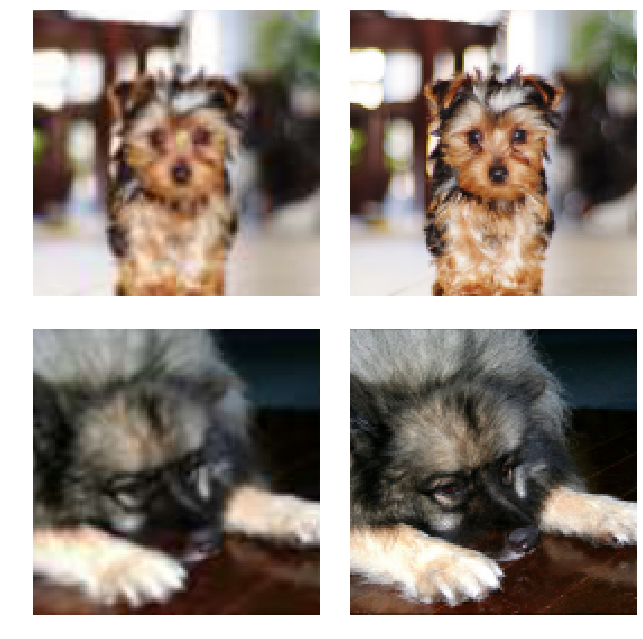

In [7]:
data.show_batch(ds_type=DatasetType.Valid, rows=2, figsize=(9,9))

# Perceptual Loss

In [11]:
t = data.valid_ds[0][1].data
t = torch.stack([t,t])

In [12]:
def gram_matrix(x):
    n,c,h,w = x.size()
    x = x.view(n, c, -1)
    return (x @ x.transpose(1,2))/(c*h*w)

In [13]:
gram_matrix(t)

tensor([[[0.1402, 0.1265, 0.1157],
         [0.1265, 0.1164, 0.1078],
         [0.1157, 0.1078, 0.1017]],

        [[0.1402, 0.1265, 0.1157],
         [0.1265, 0.1164, 0.1078],
         [0.1157, 0.1078, 0.1017]]])

In [14]:
base_loss = F.l1_loss

In [15]:
vgg_m = vgg16_bn(True).features.cuda().eval()
requires_grad(vgg_m, False)

In [16]:
blocks = [i-1 for i,o in enumerate(children(vgg_m)) if isinstance(o,nn.MaxPool2d)]
blocks, [vgg_m[i] for i in blocks]

([5, 12, 22, 32, 42],
 [ReLU(inplace), ReLU(inplace), ReLU(inplace), ReLU(inplace), ReLU(inplace)])

In [17]:
class PerceptualLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [18]:
feat_loss = PerceptualLoss(vgg_m, blocks[2:5], [5,15,2])

In [19]:
x = torch.rand([32, 256, 1024], device=0, requires_grad=True)

In [21]:
(x@x.transpose(1,2)).shape

torch.Size([32, 256, 256])

In [22]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight)
gc.collect();

The model used. Some details on model design:

A pretrained resnet34 model is used for downsampling.

Upsampling is done through a Pixel Shuffle operation to avoid checkerboard artifacts caused by transposed convolutions. For more detail see [Super-Resolution using Convolutional Neural Networks without Any Checkerboard Artifacts](https://arxiv.org/abs/1806.02658).

In [20]:
learn.model

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


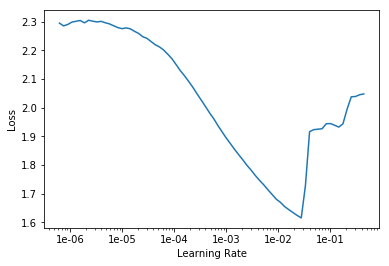

In [19]:
learn.lr_find()
learn.recorder.plot()

In [23]:
lr = 1e-3

In [24]:
def do_fit(save_name, lrs=slice(lr), pct_start=0.9):
    learn.fit_one_cycle(10, lrs, pct_start=pct_start)
    learn.save(save_name)
    learn.show_results(rows=1, imgsize=5)

The model is first trained on 128x128 images, then on 256x256 images.

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2
1,0.971816,0.891939,0.133138,0.224505,0.311297,0.223000
2,0.941272,0.864375,0.133035,0.219831,0.299138,0.212371
3,0.919659,0.847588,0.135579,0.217195,0.289911,0.204903
4,0.906567,0.840120,0.142574,0.212985,0.284822,0.199739
5,0.883702,0.817837,0.132865,0.209564,0.280414,0.194995
6,0.886157,0.817281,0.133325,0.210595,0.279019,0.194342
7,0.876113,0.811698,0.133700,0.208517,0.276955,0.192526
8,0.868919,0.796970,0.127658,0.207453,0.272689,0.189170
9,0.864285,0.799810,0.126189,0.207640,0.274717,0.191264
10,0.843104,0.771060,0.122005,0.202186,0.265323,0.181546


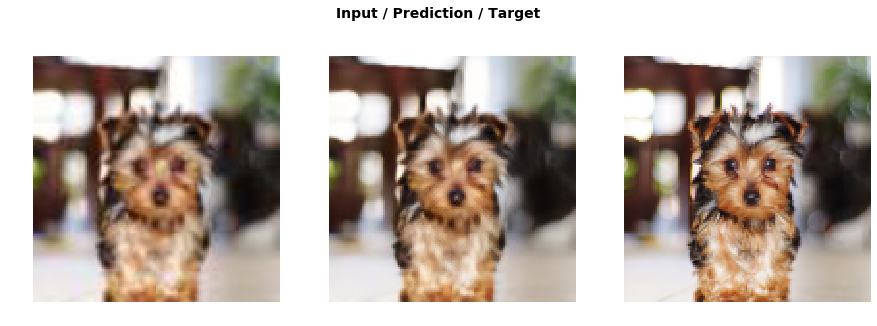

In [23]:
do_fit('percep1', slice(lr*10))

In [24]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2
1,0.836901,0.770520,0.122019,0.201923,0.265157,0.181420
2,0.838671,0.769885,0.121915,0.201683,0.264978,0.181309
3,0.834176,0.768660,0.121897,0.201440,0.264450,0.180873
4,0.835334,0.769226,0.121780,0.201629,0.264731,0.181086
5,0.838226,0.767369,0.121927,0.201021,0.264054,0.180367
6,0.832722,0.766439,0.122258,0.200643,0.263463,0.180076
7,0.835798,0.766430,0.121240,0.200533,0.264088,0.180569
8,0.832756,0.763671,0.121618,0.200097,0.262612,0.179344
9,0.828242,0.762503,0.121673,0.200020,0.262171,0.178638
10,0.830981,0.760336,0.121234,0.199624,0.261488,0.177990


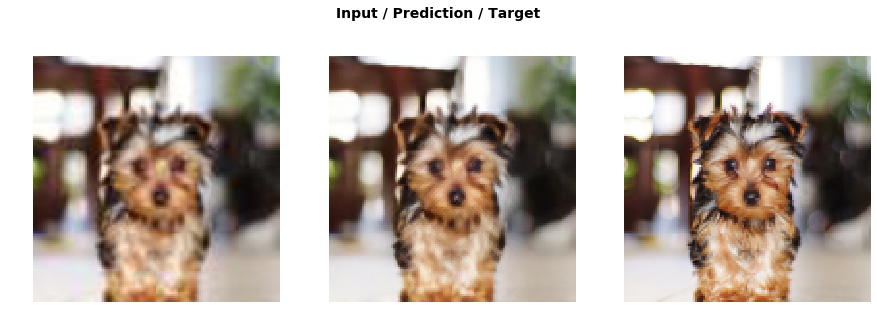

In [25]:
do_fit('percep2', slice(1e-5,1e-3))

In [19]:
learn.load('percep2');

In [20]:
data = get_data(14,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2
1,0.845397,0.806456,0.150353,0.237268,0.273073,0.145762
2,0.838010,0.802147,0.150203,0.236296,0.271074,0.144574
3,0.826656,0.795629,0.149646,0.234894,0.268293,0.142795
4,0.819439,0.791525,0.149293,0.233945,0.266782,0.141504
5,0.820053,0.787690,0.149320,0.233266,0.264857,0.140247
6,0.810310,0.786689,0.149880,0.231220,0.265110,0.140478
7,0.801559,0.781917,0.148998,0.230588,0.263147,0.139184
8,0.802414,0.779699,0.148614,0.230739,0.262178,0.138167
9,0.797953,0.777929,0.149324,0.228480,0.261576,0.138550
10,0.804592,0.773055,0.148138,0.228093,0.259585,0.137239


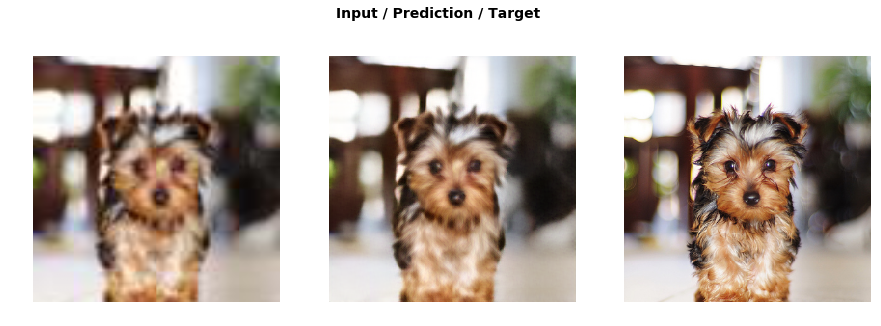

In [25]:
do_fit('percep3')

In [26]:
data = get_data(12,size*2)
learn.data = data

In [27]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2
1,0.795984,0.772925,0.148076,0.228101,0.259592,0.137156
2,0.797387,0.772644,0.148220,0.228040,0.259300,0.137083
3,0.804227,0.772043,0.147936,0.227907,0.259372,0.136828
4,0.798416,0.771828,0.148108,0.227624,0.259273,0.136823
5,0.796402,0.770858,0.147736,0.227721,0.258939,0.136462
6,0.797990,0.770559,0.147800,0.227480,0.258815,0.136463
7,0.792034,0.770552,0.147768,0.227742,0.258670,0.136371
8,0.795388,0.770169,0.147759,0.227547,0.258583,0.136280
9,0.794058,0.770019,0.147661,0.227410,0.258668,0.136280
10,0.798439,0.769992,0.147588,0.227478,0.258662,0.136264


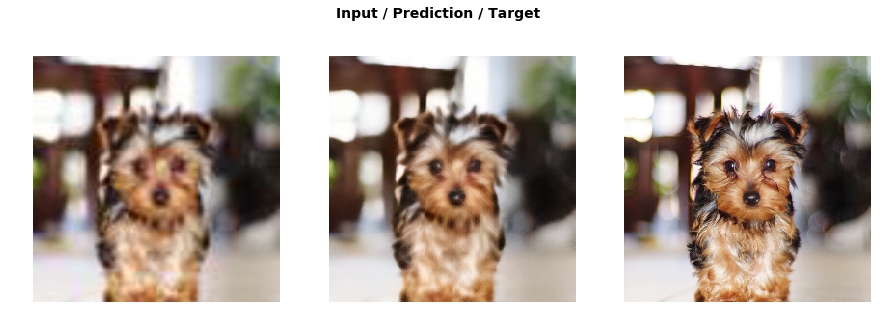

In [28]:
do_fit('percep4', slice(1e-6,1e-4), pct_start=0.3)

In [30]:
learn.load('percep4');

## Testing Perceptual Loss

Testing is done by performing a 3x upscaling of an input image.

In [26]:
def resize_one(fn,i):
    dest = path_mr/fn.relative_to(path_hr)
    dest.parent.mkdir(parents=True, exist_ok=True)
    img = PIL.Image.open(fn)
    targ_sz = resize_to(img, 256, use_min=True)
    img = img.resize(targ_sz, resample=PIL.Image.BILINEAR).convert('RGB')
    img.save(dest, quality=60)

In [27]:
for i, fn in enumerate(il.items):
    resize_one(fn, i)

In [29]:
data_mr = (ImageImageList.from_folder(path_mr).random_split_by_pct(0.1, seed=42)
          .label_from_func(lambda x: path_hr/x.name)
          .transform(get_transforms(), size=(322*3,256*3), tfm_y=True)
          .databunch(bs=2).normalize(imagenet_stats, do_y=True))

In [30]:
learn.data = data_mr

In [31]:
fn = data_mr.valid_ds.x.items[0]; fn

WindowsPath('C:/Users/GATEWAY/.fastai/data/oxford-iiit-pet/small-256/yorkshire_terrier_168.jpg')

In [32]:
img = open_image(fn); img.shape

torch.Size([3, 322, 256])

In [33]:
_,img_hr,b = learn.predict(img)

In [34]:
img_hr.shape

torch.Size([3, 966, 768])

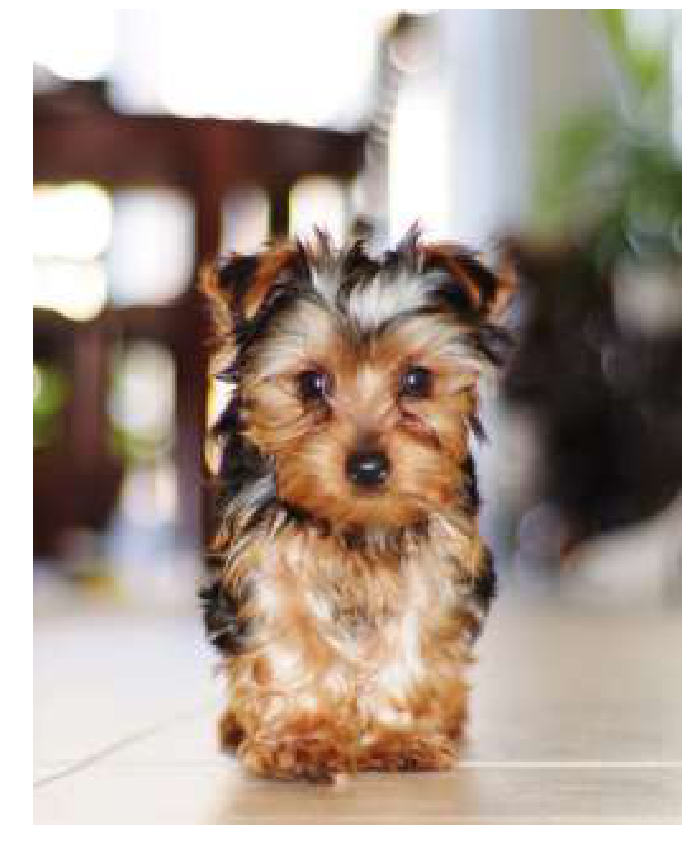

In [35]:
show_image(img, figsize=(18,15), interpolation='nearest')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


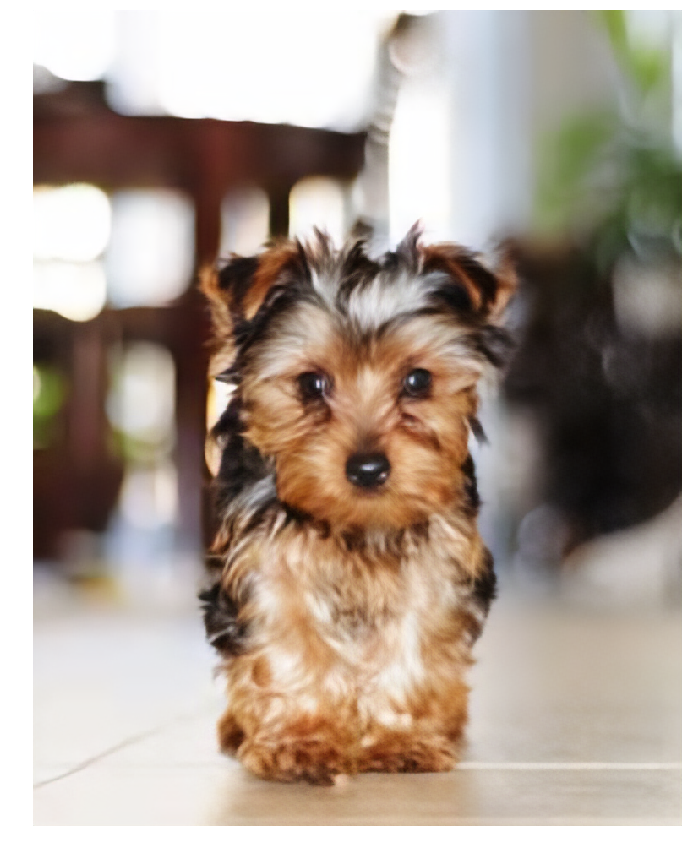

In [36]:
Image(img_hr).show(figsize=(18,15))

In [37]:
Image(img_hr.clamp(0, 1)).save('dog_percep.png')

# Gram Loss

In [38]:
class GramLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['pixel',] + [f'gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [39]:
feat_loss = GramLoss(vgg_m, blocks[2:5], [3, 0.7, 0.01])

In [40]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight)
gc.collect();

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


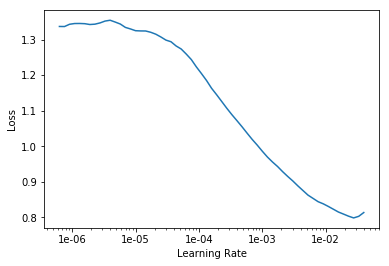

In [41]:
learn.lr_find()
learn.recorder.plot()

In [42]:
lr = 1e-3

epoch,train_loss,valid_loss,pixel,gram_0,gram_1,gram_2
1,0.313050,0.310359,0.164824,0.143949,0.001575,0.000011
2,0.303307,0.303176,0.163813,0.137845,0.001507,0.000011
3,0.300858,0.298948,0.161990,0.135458,0.001489,0.000011
4,0.294551,0.293499,0.161709,0.130259,0.001520,0.000011
5,0.295154,0.284768,0.157201,0.126093,0.001464,0.000011
6,0.291104,0.283868,0.157636,0.124771,0.001450,0.000011
7,0.286104,0.285840,0.156836,0.127551,0.001442,0.000011
8,0.285115,0.280955,0.154633,0.124871,0.001440,0.000011
9,0.282791,0.277722,0.153208,0.123054,0.001449,0.000011
10,0.279668,0.272394,0.153109,0.117848,0.001425,0.000011


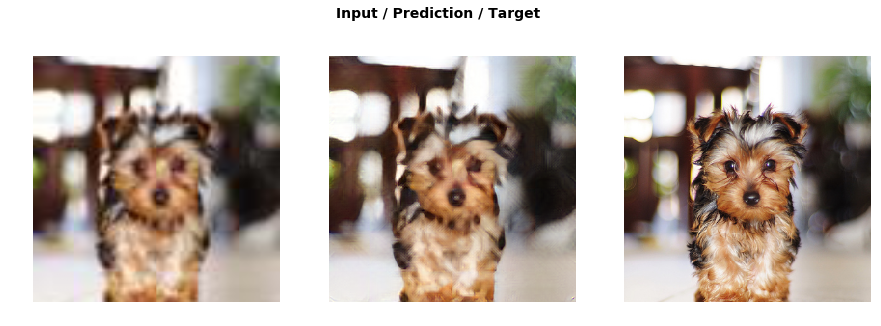

In [43]:
do_fit('gram1', slice(lr*10))

In [44]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,gram_0,gram_1,gram_2
1,0.278801,0.272142,0.152919,0.117789,0.001424,0.000011
2,0.279518,0.271746,0.152791,0.117521,0.001423,0.000011
3,0.278321,0.271469,0.152525,0.117516,0.001417,0.000011
4,0.274215,0.271104,0.152307,0.117370,0.001417,0.000011
5,0.278581,0.271175,0.152955,0.116788,0.001421,0.000011
6,0.272759,0.270678,0.151818,0.117438,0.001410,0.000011
7,0.279024,0.270729,0.152658,0.116647,0.001413,0.000011
8,0.279408,0.272627,0.154245,0.116949,0.001422,0.000011
9,0.277800,0.269516,0.152176,0.115916,0.001413,0.000011
10,0.275222,0.269394,0.151846,0.116130,0.001406,0.000011


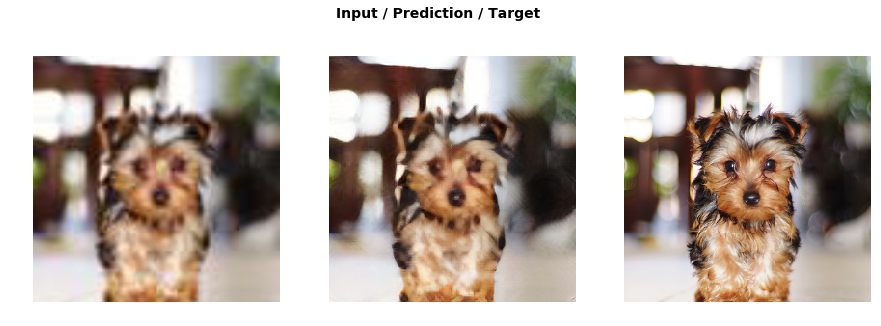

In [45]:
do_fit('gram2', slice(1e-5,1e-3))

In [28]:
learn.load('gram2');

In [46]:
data = get_data(9,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,gram_0,gram_1,gram_2
1,0.271388,0.269324,0.152052,0.115851,0.001410,0.000011
2,0.278347,0.269612,0.151917,0.116279,0.001405,0.000011
3,0.276875,0.269644,0.152067,0.116149,0.001418,0.000011
4,0.273913,0.269567,0.152155,0.115989,0.001412,0.000011
5,0.272707,0.270704,0.153071,0.116216,0.001406,0.000011
6,0.272787,0.269531,0.151760,0.116357,0.001403,0.000011
7,0.275964,0.269682,0.151791,0.116477,0.001403,0.000011
8,0.275818,0.269273,0.152304,0.115548,0.001411,0.000011
9,0.278453,0.268262,0.151530,0.115328,0.001393,0.000011
10,0.275233,0.268107,0.151400,0.115295,0.001401,0.000011


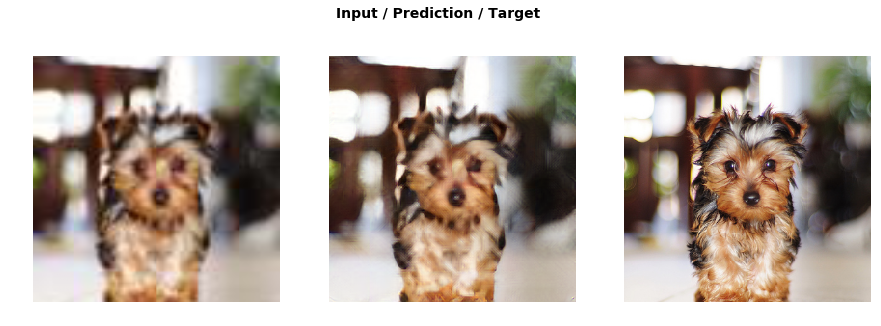

In [47]:
do_fit('gram3')

In [48]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,gram_0,gram_1,gram_2
1,0.274188,0.267992,0.151345,0.115239,0.001397,0.000011
2,0.276224,0.267944,0.151553,0.114980,0.001399,0.000011
3,0.271841,0.268050,0.151406,0.115235,0.001398,0.000011
4,0.276190,0.267936,0.151526,0.115003,0.001397,0.000011
5,0.274835,0.268029,0.151633,0.114988,0.001397,0.000011
6,0.273364,0.267953,0.151692,0.114847,0.001403,0.000011
7,0.273052,0.267762,0.151524,0.114831,0.001396,0.000011
8,0.273709,0.267735,0.151469,0.114858,0.001397,0.000011
9,0.279426,0.267846,0.151526,0.114911,0.001398,0.000011
10,0.276649,0.267627,0.151254,0.114967,0.001395,0.000011


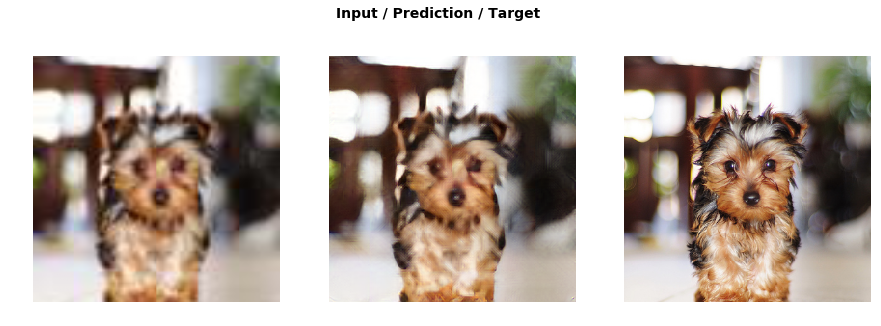

In [49]:
do_fit('gram4', slice(1e-6,1e-4), pct_start=0.3)

In [30]:
learn.load('gram4');

## Testing Gram Loss

In [50]:
learn.data = data_mr

In [51]:
_,img_hr,b = learn.predict(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


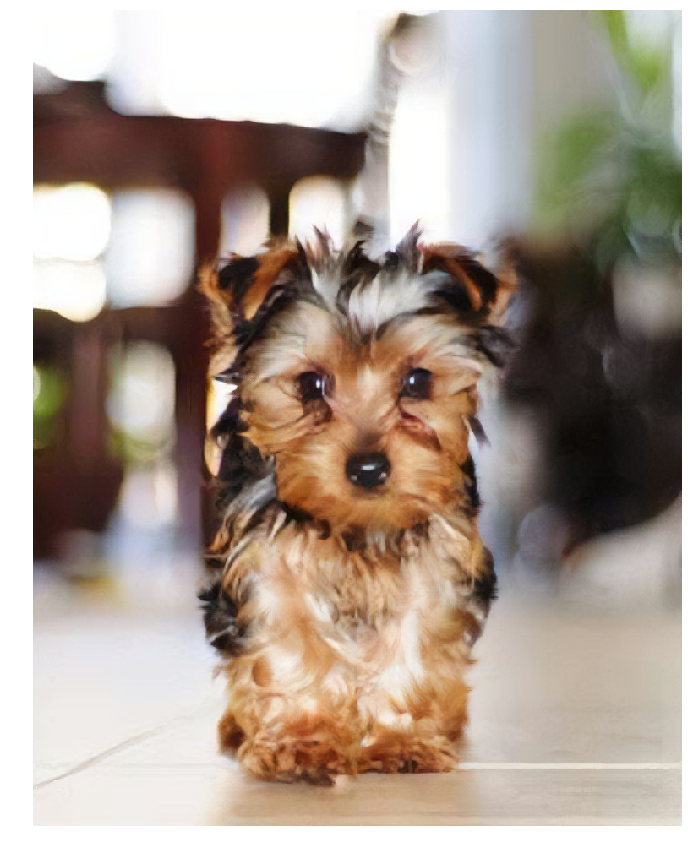

In [52]:
Image(img_hr).show(figsize=(18,15))

In [53]:
Image(img_hr.clamp(0, 1)).save('dog_gram.png')

# Wasserstein Loss

In [19]:
def calc_2_moments(tensor):
    chans = tensor.shape[1]
    tensor = tensor.view(1, chans, -1)
    n = tensor.shape[2]
    
    mu = tensor.mean(2)
    tensor = (tensor - mu[:,:,None]).squeeze(0)
    cov = torch.mm(tensor, tensor.t()) / float(n)
    
    return mu, cov

In [20]:
def get_style_vals(tensor):
    mean, cov = calc_2_moments(tensor)
    
    eigvals, eigvects = torch.symeig(cov, eigenvectors=True)
    
    eigroot_mat = torch.diag(torch.sqrt(eigvals.clamp(min=0)))
    
    root_cov = torch.mm(torch.mm(eigvects, eigroot_mat), eigvects.t())
    
    tr_cov = eigvals.clamp(min=0).sum()
    
    return mean, tr_cov, root_cov

In [21]:
def calc_l2wass_dist(mean_stl, tr_cov_stl, root_cov_stl, mean_synth, cov_synth):
    
    tr_cov_synth = torch.symeig(cov_synth, eigenvectors=True)[0].clamp(min=0).sum()
    
    mean_diff_squared = (mean_stl - mean_synth).pow(2).sum()
    
    cov_prod = torch.mm(torch.mm(root_cov_stl, cov_synth), root_cov_stl)
    
    var_overlap = torch.sqrt(torch.symeig(cov_prod, eigenvectors=True)[0].clamp(min=0)+1e-8).sum()
    
    dist = mean_diff_squared + tr_cov_stl + tr_cov_synth - 2*var_overlap
    
    return dist

In [22]:
def single_wass_loss(pred, targ):
    mean_test, tr_cov_test, root_cov_test = targ
    mean_synth, cov_synth = calc_2_moments(pred)
    loss = calc_l2wass_dist(mean_test, tr_cov_test, root_cov_test, mean_synth, cov_synth)
    return loss

In [25]:
class WassLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, wass_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wass_wgts = wass_wgts
        self.metric_names = ['pixel',] + [f'wass_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]

        styles = [get_style_vals(i) for i in out_feat]
        self.feat_losses += [single_wass_loss(f_pred, f_targ)*w
                            for f_pred, f_targ, w in zip(in_feat, styles, self.wass_wgts)]
        
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [26]:
feat_loss = WassLoss(vgg_m, blocks[2:5], [3, 0.7, 0.01])

In [27]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight)
gc.collect();

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


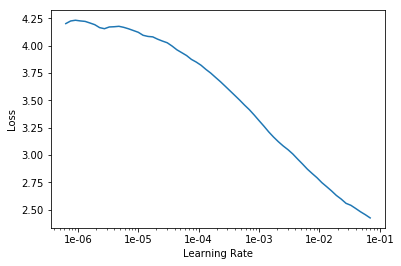

In [28]:
learn.lr_find()
learn.recorder.plot()

In [29]:
lr = 1e-3

epoch,train_loss,valid_loss,pixel,wass_0,wass_1,wass_2
1,0.797819,0.693964,0.147703,0.129487,0.146384,0.270390
2,0.719900,0.667424,0.158399,0.124305,0.139719,0.245001
3,0.684862,0.608974,0.138196,0.111898,0.126791,0.232089
4,0.662352,0.598356,0.142943,0.106902,0.121634,0.226877
5,0.657644,0.595109,0.141595,0.108233,0.124106,0.221175
6,0.641793,0.564855,0.139861,0.101204,0.114609,0.209181
7,0.633191,0.575686,0.144498,0.104052,0.115157,0.211979
8,0.622538,0.550179,0.133332,0.097055,0.112219,0.207574
9,0.611023,0.547295,0.138159,0.097201,0.110003,0.201931
10,0.578283,0.506227,0.128849,0.088393,0.102721,0.186263


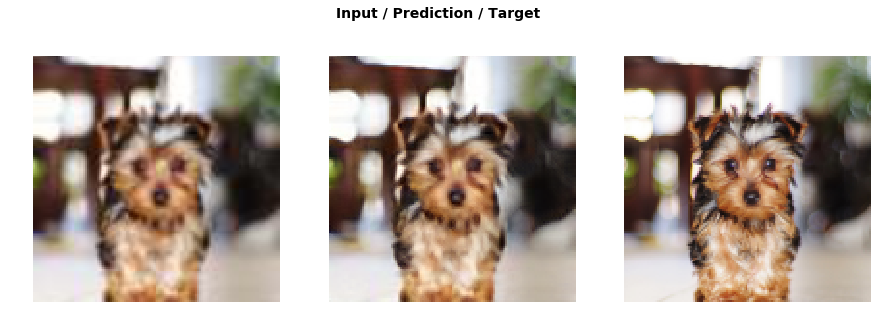

In [32]:
do_fit('wass_only1', slice(lr*10))

In [33]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,wass_0,wass_1,wass_2
1,0.570240,0.505093,0.129383,0.087453,0.102446,0.185810
2,0.575283,0.504316,0.129722,0.086970,0.102330,0.185293
3,0.566289,0.501661,0.129613,0.086489,0.101776,0.183782
4,0.563355,0.499505,0.129327,0.086319,0.101239,0.182619
5,0.569721,0.500821,0.129107,0.086355,0.101509,0.183850
6,0.566018,0.499415,0.129059,0.085959,0.101550,0.182848
7,0.567723,0.498909,0.129443,0.085888,0.100859,0.182718
8,0.573965,0.495470,0.128997,0.085291,0.099875,0.181306
9,0.568344,0.496584,0.128973,0.084813,0.100231,0.182567
10,0.562911,0.494314,0.128392,0.084721,0.099866,0.181334


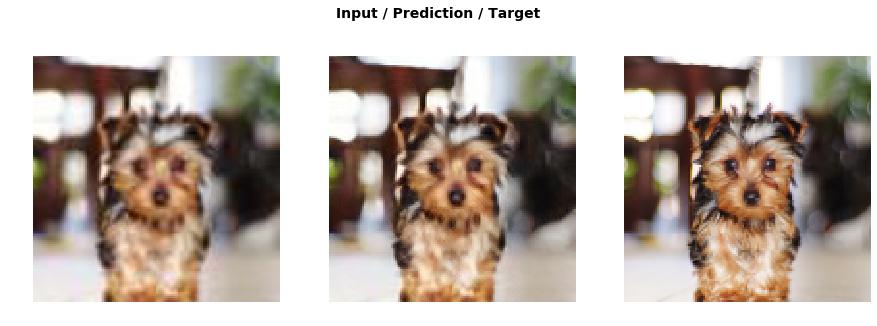

In [34]:
do_fit('wass_only2', slice(1e-5,1e-3))

In [28]:
learn.load('wass_only2');

In [35]:
data = get_data(9,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,wass_0,wass_1,wass_2
1,0.709721,0.642674,0.161812,0.190861,0.134574,0.155428
2,0.685617,0.634051,0.162986,0.185712,0.133000,0.152353
3,0.669271,0.625225,0.163958,0.179920,0.130592,0.150755
4,0.665140,0.617298,0.162527,0.179047,0.128178,0.147546
5,0.653103,0.609812,0.163208,0.173851,0.127214,0.145540
6,0.641303,0.599507,0.161997,0.168948,0.126140,0.142422
7,0.629736,0.596856,0.161394,0.170420,0.124759,0.140283
8,0.638247,0.597219,0.164265,0.167281,0.125022,0.140651
9,0.624495,0.593115,0.162108,0.164113,0.127979,0.138914
10,0.613201,0.575709,0.161174,0.158243,0.120317,0.135975


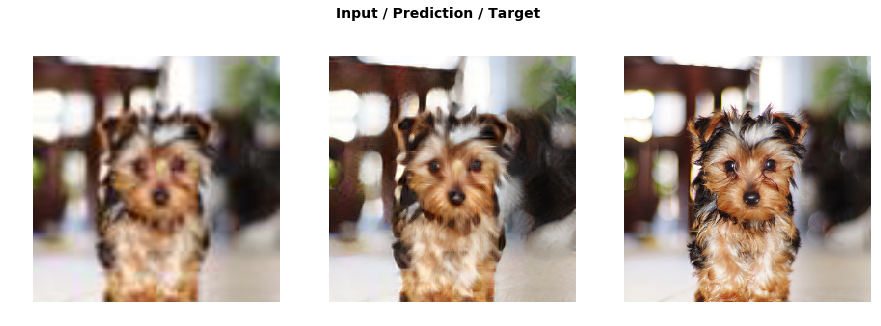

In [36]:
do_fit('wass_only3')

In [37]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,wass_0,wass_1,wass_2
1,0.607265,0.576151,0.161513,0.157986,0.120414,0.136239
2,0.613698,0.575040,0.161224,0.158729,0.119719,0.135368
3,0.615689,0.572580,0.161161,0.156921,0.119292,0.135206
4,0.604370,0.570635,0.160200,0.157004,0.118949,0.134482
5,0.603730,0.569960,0.159978,0.157053,0.119113,0.133816
6,0.611611,0.568216,0.160102,0.155951,0.118551,0.133612
7,0.604447,0.567931,0.160110,0.155906,0.118699,0.133216
8,0.594417,0.567322,0.160449,0.155742,0.118345,0.132785
9,0.600586,0.567572,0.160757,0.155456,0.118403,0.132955
10,0.601192,0.568561,0.161238,0.155427,0.118657,0.133239


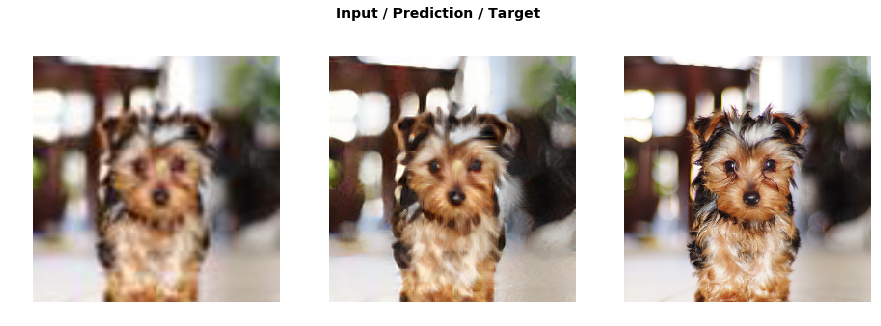

In [38]:
do_fit('wass_only4', slice(1e-6,1e-4), pct_start=0.3)

In [30]:
learn.load('wass_only4');

## Testing Wasserstein Loss

In [49]:
learn.data = data_mr

In [52]:
_,img_hr,b = learn.predict(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


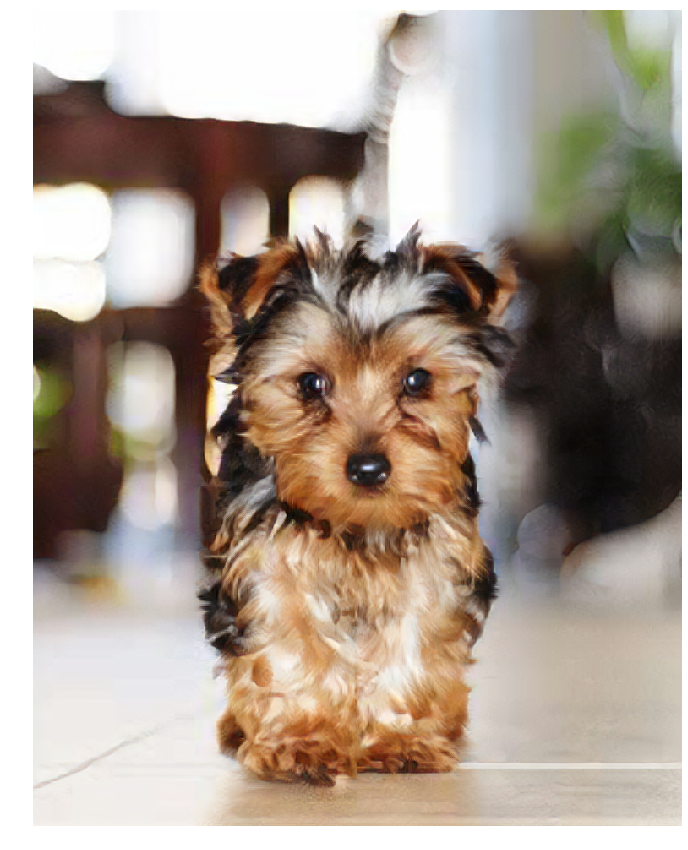

In [55]:
Image(img_hr).show(figsize=(18,15))

In [56]:
Image(img_hr.clamp(0, 1)).save('dog_wass_only.png')

## Perceptual + Gram Loss

In [13]:
class FeatureLoss(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))
              ] + [f'gram_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.feat_losses += [base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [14]:
feat_loss = FeatureLoss(vgg_m, blocks[2:5], [5,15,2])

In [54]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight)
gc.collect();

In [25]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


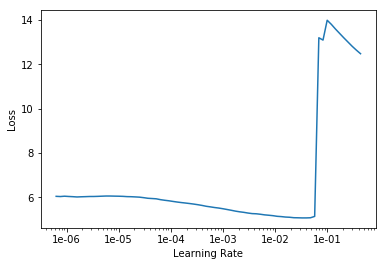

In [26]:
learn.recorder.plot()

In [19]:
lr = 1e-3

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,3.856792,3.660514,0.138690,0.226913,0.311552,0.220814,0.542197,1.188433,1.031914
2,3.757784,3.586591,0.145475,0.225830,0.308171,0.216142,0.521335,1.163885,1.005752
3,3.698635,3.552859,0.160265,0.224428,0.303586,0.211986,0.517506,1.147033,0.988055
4,3.636693,3.446877,0.150981,0.223065,0.297097,0.205665,0.490544,1.112985,0.966540
5,3.599071,3.402726,0.146675,0.223108,0.295965,0.204424,0.479825,1.095728,0.957001
6,3.549419,3.348646,0.143582,0.221239,0.291713,0.200093,0.472537,1.084853,0.934629
7,3.501148,3.308120,0.142986,0.218997,0.289682,0.197495,0.463762,1.072487,0.922710
8,3.494425,3.315300,0.144464,0.217813,0.287534,0.195896,0.473111,1.080775,0.915707
9,3.452017,3.246237,0.135877,0.215101,0.282339,0.193906,0.456137,1.050667,0.912211
10,3.349576,3.148344,0.132917,0.213941,0.277311,0.188221,0.429004,1.021180,0.885769


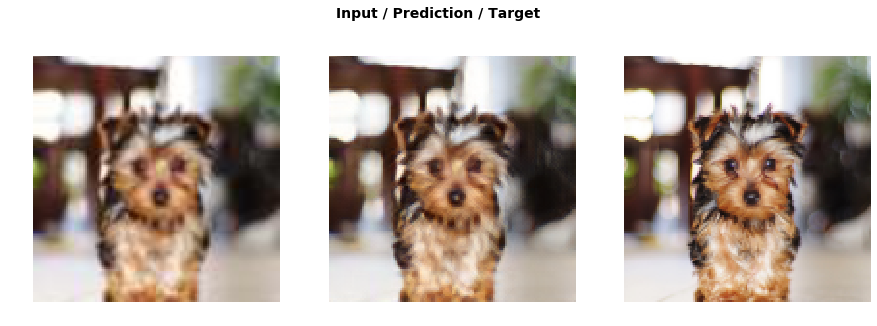

In [29]:
do_fit('1a', slice(lr*10))

In [30]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,3.332573,3.139793,0.132707,0.213636,0.276887,0.187715,0.427191,1.018955,0.882702
2,3.346102,3.135309,0.132946,0.213597,0.276850,0.187320,0.426424,1.018118,0.880054
3,3.337538,3.134222,0.133280,0.213666,0.276832,0.187271,0.425903,1.018141,0.879128
4,3.306235,3.123149,0.132091,0.213184,0.275980,0.186384,0.425406,1.014890,0.875215
5,3.316702,3.120188,0.132521,0.213056,0.275710,0.186225,0.424482,1.014449,0.873746
6,3.309889,3.111803,0.132828,0.213070,0.275376,0.185850,0.420813,1.010954,0.872913
7,3.302011,3.107904,0.133320,0.212417,0.274878,0.185711,0.419880,1.009180,0.872519
8,3.312692,3.104459,0.132008,0.212162,0.274717,0.185225,0.421421,1.010143,0.868783
9,3.280643,3.089353,0.132651,0.211686,0.273490,0.184334,0.418741,1.003738,0.864714
10,3.279658,3.082762,0.132477,0.211563,0.273222,0.184048,0.416163,1.002324,0.862965


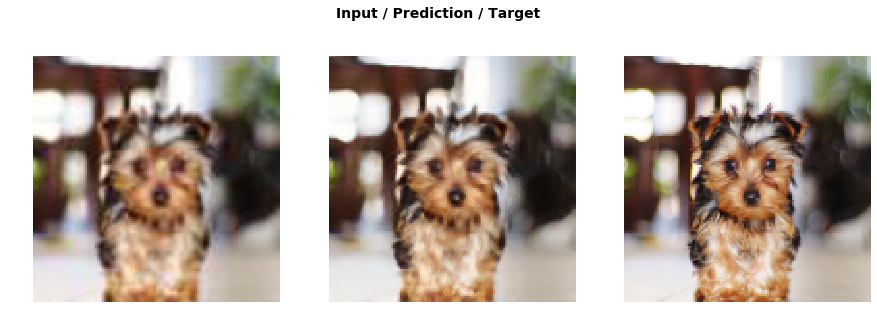

In [31]:
do_fit('1b', slice(1e-5,1e-3))

In [21]:
learn.load('1b');

In [22]:
data = get_data(12,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.255455,2.191262,0.159788,0.257375,0.293782,0.154947,0.378480,0.582728,0.364161
2,2.213335,2.168999,0.160500,0.258275,0.293408,0.154544,0.366456,0.574498,0.361318
3,2.188850,2.149735,0.160464,0.257581,0.291706,0.153050,0.359651,0.569035,0.358249
4,2.187657,2.134002,0.161429,0.257328,0.289505,0.152003,0.354427,0.564164,0.355145
5,2.159491,2.118266,0.162217,0.257729,0.288738,0.150710,0.346626,0.560238,0.352007
6,2.137944,2.111776,0.163177,0.256810,0.287540,0.150509,0.343875,0.558458,0.351407
7,2.143130,2.110916,0.165885,0.258167,0.286696,0.149398,0.341668,0.561540,0.347562
8,2.120176,2.082875,0.159604,0.254634,0.283528,0.147006,0.342767,0.551367,0.343969
9,2.097864,2.086975,0.162223,0.256355,0.284144,0.147633,0.338161,0.553815,0.344645
10,2.085669,2.063643,0.162130,0.254773,0.282438,0.146233,0.332019,0.545039,0.341010


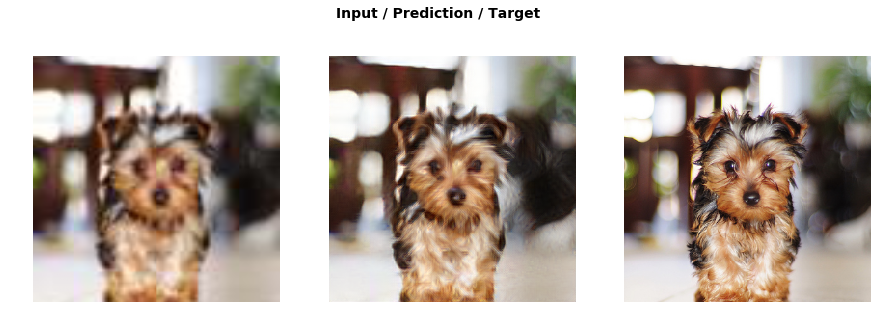

In [26]:
do_fit('2a')

In [27]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.080867,2.061548,0.162349,0.254648,0.282297,0.146013,0.331051,0.544605,0.340584
2,2.073157,2.060124,0.162520,0.254343,0.281939,0.146122,0.331028,0.543554,0.340617
3,2.073347,2.057163,0.162641,0.254641,0.282356,0.145926,0.328828,0.543075,0.339697
4,2.076585,2.053968,0.161838,0.254332,0.281459,0.145361,0.329812,0.542183,0.338984
5,2.075442,2.050757,0.161706,0.253855,0.281098,0.144958,0.329397,0.541846,0.337896
6,2.077195,2.047863,0.161410,0.253681,0.281301,0.144978,0.327825,0.540767,0.337901
7,2.075271,2.047019,0.161219,0.253540,0.280816,0.144784,0.328641,0.540494,0.337525
8,2.054607,2.047896,0.162231,0.254228,0.281217,0.144904,0.327391,0.540377,0.337549
9,2.061451,2.046389,0.161763,0.254039,0.281292,0.144961,0.326140,0.540400,0.337794
10,2.071467,2.047413,0.162227,0.254443,0.281522,0.145046,0.326001,0.540455,0.337718


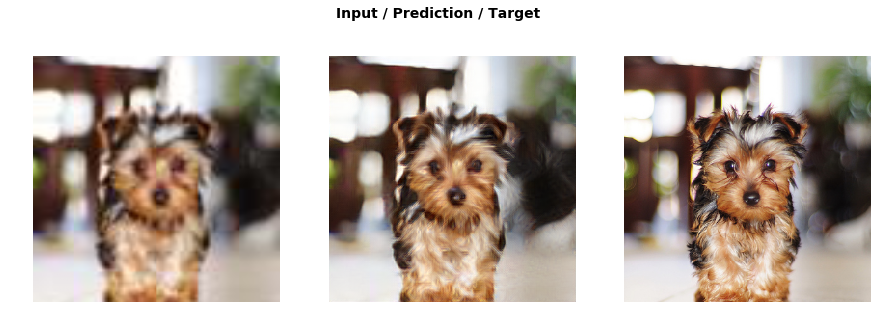

In [28]:
do_fit('2b', slice(1e-6,1e-4), pct_start=0.3)

In [55]:
learn.load('2b');

## Testing Gram + Perceptual Loss

In [56]:
learn.data = data_mr

In [57]:
_,img_hr,b = learn.predict(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


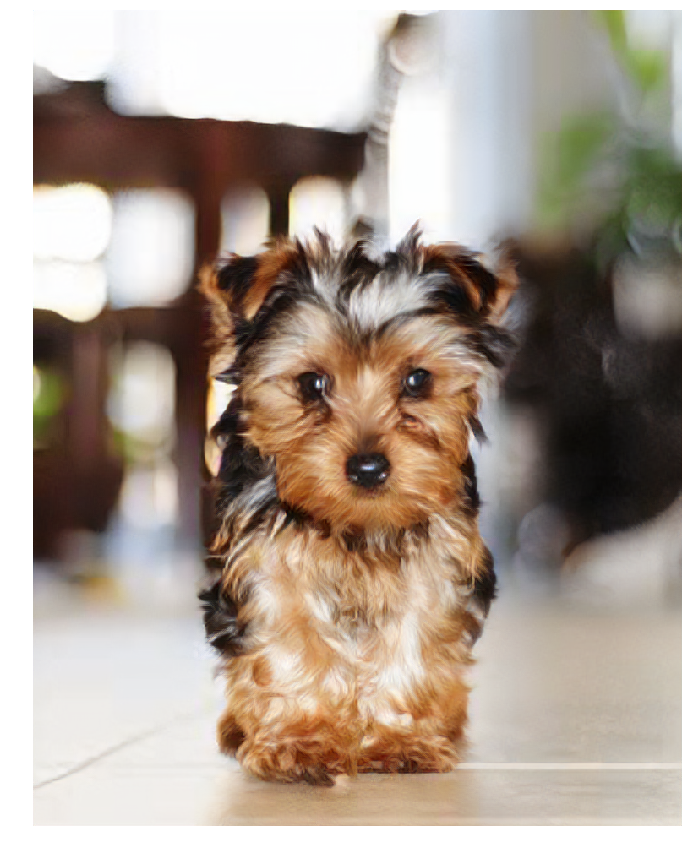

In [58]:
Image(img_hr).show(figsize=(18,15))

In [59]:
Image(img_hr.clamp(0, 1)).save('dog_percep_gram.png')

# Perceptual + Wasserstein Loss

In [27]:
class FeatureLoss_Wass(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts, wass_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.wass_wgts = wass_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))
              ] + [f'wass_{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        
        styles = [get_style_vals(i) for i in out_feat]
        self.feat_losses += [single_wass_loss(f_pred, f_targ)*w
                            for f_pred, f_targ, w in zip(in_feat, styles, self.wass_wgts)]
        
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [28]:
feat_loss = FeatureLoss_Wass(vgg_m, blocks[2:5], [5,15,2], [3, 0.7, 0.01])

In [29]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight)
gc.collect();

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


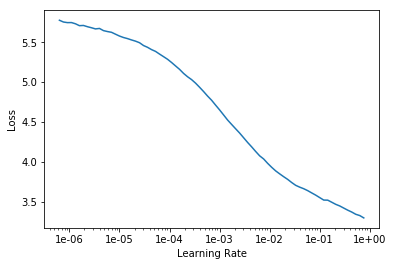

In [29]:
learn.lr_find()
learn.recorder.plot()

In [30]:
lr = 1e-3

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2
1,1.660817,1.482115,0.146786,0.235721,0.326485,0.233332,0.133813,0.145554,0.260425
2,1.565655,1.428176,0.145866,0.231948,0.318880,0.224852,0.128186,0.138317,0.240127
3,1.498038,1.389469,0.156691,0.230026,0.310917,0.218881,0.117450,0.129894,0.225611
4,1.465263,1.304869,0.140233,0.222463,0.297594,0.209784,0.106235,0.116109,0.212452
5,1.436787,1.275035,0.138291,0.222090,0.294812,0.206216,0.100180,0.111301,0.202147
6,1.407705,1.262699,0.142267,0.220969,0.291245,0.202900,0.098924,0.109683,0.196712
7,1.385219,1.248406,0.143822,0.218902,0.289696,0.201788,0.095931,0.106674,0.191593
8,1.402921,1.226085,0.132682,0.218537,0.287539,0.199519,0.092903,0.105605,0.189299
9,1.358588,1.221884,0.133996,0.217954,0.286790,0.199075,0.093454,0.103706,0.186909
10,1.307840,1.164689,0.128168,0.212338,0.277397,0.189969,0.085957,0.097853,0.173008


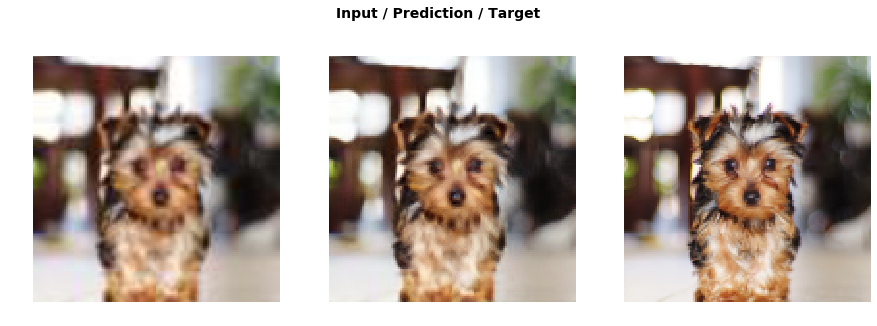

In [33]:
do_fit('wass1', slice(lr*10))

In [35]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2
1,1.300814,1.160348,0.128057,0.212241,0.276753,0.189333,0.084962,0.097011,0.171991
2,1.302118,1.156918,0.128256,0.211894,0.276347,0.188721,0.084465,0.096528,0.170707
3,1.297404,1.154711,0.127942,0.211389,0.275817,0.188409,0.084620,0.096393,0.170141
4,1.293244,1.155118,0.127971,0.211560,0.275888,0.188476,0.084281,0.095877,0.171066
5,1.285335,1.148906,0.127728,0.210951,0.274995,0.187291,0.084265,0.095327,0.168349
6,1.277689,1.147386,0.126848,0.210727,0.274454,0.187530,0.083587,0.095545,0.168694
7,1.281720,1.145017,0.127684,0.210601,0.273803,0.186632,0.083488,0.094791,0.168017
8,1.276357,1.139649,0.127577,0.209722,0.272994,0.185827,0.083331,0.093965,0.166234
9,1.275003,1.140177,0.128308,0.210266,0.273288,0.186546,0.081085,0.093732,0.166951
10,1.271719,1.132902,0.126973,0.209388,0.272206,0.184984,0.081220,0.093225,0.164905


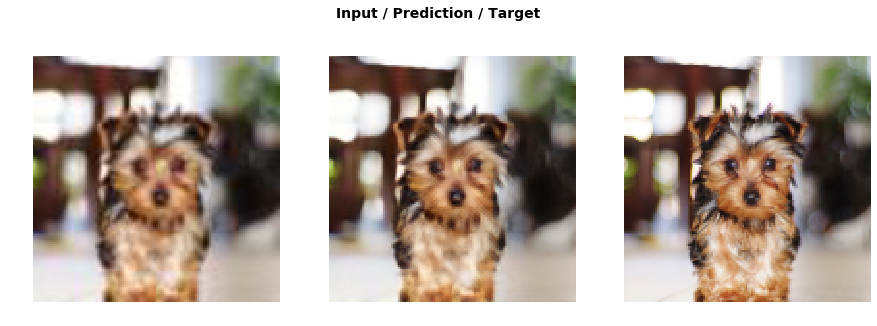

In [36]:
do_fit('wass2', slice(1e-5,1e-3))

In [28]:
learn.load('wass2');

In [31]:
data = get_data(9,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2
1,1.411775,1.281620,0.157822,0.257205,0.295668,0.156439,0.173816,0.113896,0.126773
2,1.386230,1.273739,0.158604,0.257914,0.294317,0.155009,0.168976,0.113162,0.125757
3,1.370118,1.265741,0.160186,0.258827,0.293499,0.154509,0.163865,0.110877,0.123979
4,1.340825,1.254819,0.160511,0.257165,0.290978,0.152359,0.160855,0.110674,0.122278
5,1.325203,1.242971,0.160306,0.256435,0.288898,0.151471,0.158105,0.107872,0.119884
6,1.324281,1.236518,0.160552,0.256183,0.287384,0.150129,0.156925,0.106822,0.118523
7,1.315408,1.234664,0.162708,0.256537,0.286694,0.150407,0.153755,0.106776,0.117787
8,1.306813,1.216393,0.158462,0.253485,0.283635,0.148233,0.151625,0.105208,0.115745
9,1.310836,1.220955,0.161911,0.256698,0.284777,0.147837,0.147940,0.106025,0.115766
10,1.280011,1.201123,0.158346,0.253812,0.282216,0.146518,0.144399,0.102895,0.112937


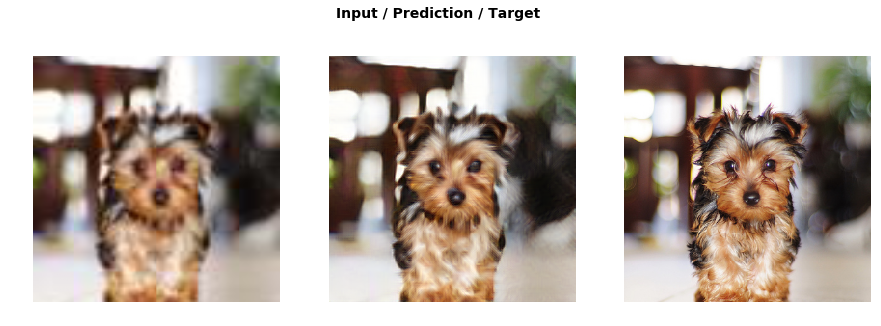

In [34]:
do_fit('wass3')

In [32]:
learn.load('wass3');

In [33]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2
1,1.300575,1.227738,0.157626,0.252408,0.280913,0.145904,0.159469,0.112924,0.118495
2,1.305033,1.229012,0.158927,0.253571,0.282197,0.146435,0.156564,0.112749,0.118569
3,1.311292,1.225877,0.157281,0.252428,0.280894,0.145935,0.158370,0.112798,0.118170
4,1.298500,1.222709,0.157875,0.252553,0.280832,0.145459,0.156533,0.111788,0.117669
5,1.284924,1.220213,0.157886,0.252603,0.280263,0.145282,0.155620,0.111548,0.117010
6,1.303545,1.220074,0.158007,0.252867,0.280587,0.145556,0.154817,0.111253,0.116988
7,1.300067,1.220671,0.158750,0.253264,0.280756,0.145576,0.154120,0.111195,0.117009
8,1.290582,1.218086,0.158440,0.252590,0.280350,0.145083,0.153875,0.111040,0.116707
9,1.283320,1.218454,0.157954,0.252635,0.280150,0.144993,0.154728,0.111333,0.116661
10,1.292680,1.217696,0.157392,0.252099,0.279716,0.144804,0.155647,0.111391,0.116645


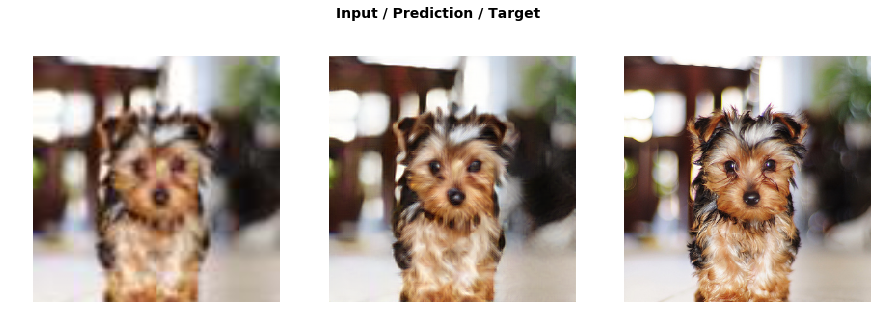

In [34]:
do_fit('wass4', slice(1e-6,1e-4), pct_start=0.3)

In [30]:
learn.load('wass4');

## Testing Perceptual + Wasserstein Loss

In [32]:
learn.data = data_mr

In [35]:
_,img_hr,b = learn.predict(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


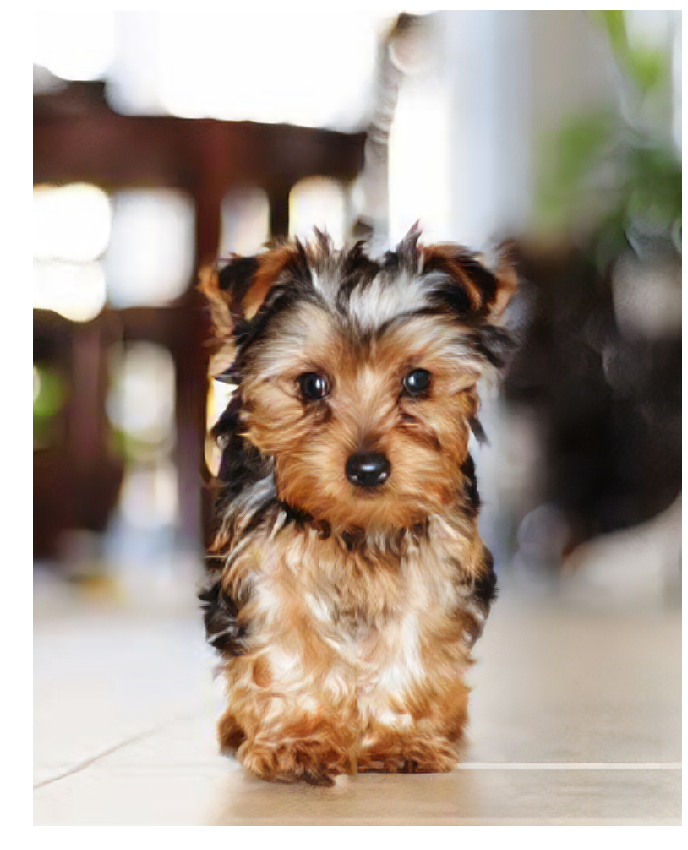

In [55]:
Image(img_hr).show(figsize=(18,15))

In [56]:
Image(img_hr.clamp(0, 1)).save('dog_wass.png')

# Perceptual + Gram + Wasserstein Loss

In [29]:
class FeatureLoss_Wass_Gram(nn.Module):
    def __init__(self, m_feat, layer_ids, layer_wgts, wass_wgts):
        super().__init__()
        self.m_feat = m_feat
        self.loss_features = [self.m_feat[i] for i in layer_ids]
        self.hooks = hook_outputs(self.loss_features, detach=False)
        self.wgts = layer_wgts
        self.wass_wgts = wass_wgts
        self.metric_names = ['pixel',] + [f'feat_{i}' for i in range(len(layer_ids))
              ] + [f'wass_{i}' for i in range(len(layer_ids))] + [f'gram{i}' for i in range(len(layer_ids))]

    def make_features(self, x, clone=False):
        self.m_feat(x)
        return [(o.clone() if clone else o) for o in self.hooks.stored]
    
    def forward(self, input, target):
        out_feat = self.make_features(target, clone=True)
        in_feat = self.make_features(input)
        self.feat_losses = [base_loss(input,target)]
        self.feat_losses += [base_loss(f_in, f_out)*w
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        
        styles = [get_style_vals(i) for i in out_feat]
        self.feat_losses += [single_wass_loss(f_pred, f_targ)*w*2
                            for f_pred, f_targ, w in zip(in_feat, styles, self.wass_wgts)]
        
        
        self.feat_losses += [base_loss(gram_matrix(f_in), gram_matrix(f_out))*w**2 * 5e3
                             for f_in, f_out, w in zip(in_feat, out_feat, self.wgts)]
        self.metrics = dict(zip(self.metric_names, self.feat_losses))
        return sum(self.feat_losses)
    
    def __del__(self): self.hooks.remove()

In [58]:
feat_loss = FeatureLoss_Wass_Gram(vgg_m, blocks[2:5], [5,15,2], [3, 0.7, 0.01])

In [59]:
data = get_data(bs,size)
learn.data = data
learn.freeze()

In [60]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight)
gc.collect();

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


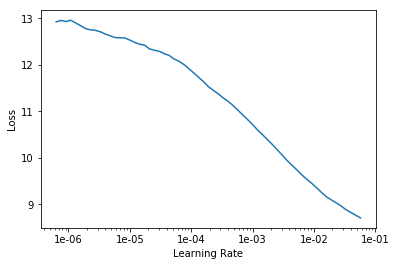

In [39]:
learn.lr_find()
learn.recorder.plot()

In [40]:
lr = 1e-3

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2,gram0,gram1,gram2
1,5.257045,4.872715,0.145411,0.234672,0.320022,0.224568,0.265666,0.299979,0.508910,0.583558,1.241726,1.048204
2,4.972568,4.647574,0.152851,0.230613,0.310783,0.218275,0.238337,0.257203,0.469926,0.557784,1.188287,1.023514
3,4.827655,4.439938,0.146452,0.228490,0.305548,0.210968,0.226878,0.246785,0.439076,0.508801,1.144932,0.982008
4,4.713406,4.353233,0.142595,0.226331,0.299631,0.206971,0.211313,0.245019,0.430135,0.499848,1.124555,0.966835
5,4.628282,4.247445,0.142615,0.226042,0.297230,0.204372,0.202172,0.224327,0.405513,0.482534,1.103758,0.958883
6,4.547316,4.194489,0.148486,0.224221,0.294744,0.200720,0.196930,0.221386,0.393825,0.473244,1.101577,0.939355
7,4.528504,4.142304,0.141380,0.223443,0.293720,0.201073,0.189117,0.216371,0.392757,0.460580,1.084123,0.939738
8,4.466175,4.090457,0.138216,0.218877,0.287806,0.197437,0.190606,0.216621,0.390395,0.457145,1.069727,0.923626
9,4.417419,4.096799,0.141827,0.217689,0.286548,0.197193,0.189148,0.213773,0.384953,0.468718,1.074527,0.922424
10,4.290212,3.897574,0.135383,0.216802,0.281334,0.189995,0.170969,0.198098,0.355191,0.426988,1.032457,0.890355


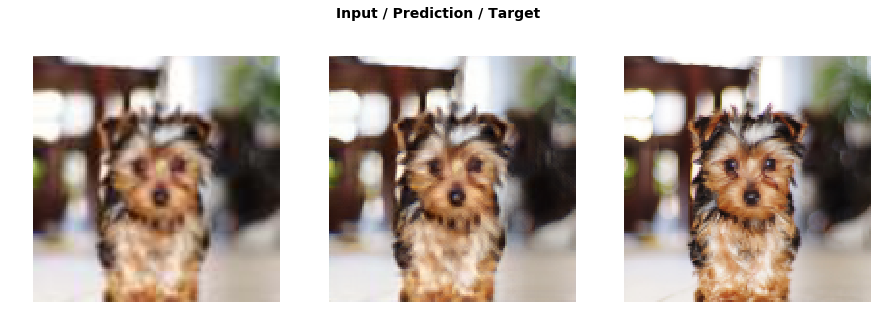

In [41]:
do_fit('wass_gram1', slice(lr*10))

In [42]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2,gram0,gram1,gram2
1,4.233572,3.886729,0.134677,0.216470,0.280505,0.189541,0.170553,0.197602,0.353137,0.426134,1.029946,0.888163
2,4.221993,3.877486,0.134583,0.216234,0.279935,0.189080,0.170201,0.196890,0.351933,0.425115,1.027537,0.885978
3,4.213851,3.873909,0.134623,0.215954,0.279551,0.188902,0.170338,0.196711,0.351372,0.425312,1.026608,0.884537
4,4.189290,3.872690,0.133497,0.215274,0.278911,0.188589,0.169026,0.196331,0.350996,0.428305,1.027684,0.884079
5,4.172455,3.860099,0.133738,0.214972,0.278434,0.188317,0.168527,0.195147,0.350116,0.424230,1.023777,0.882841
6,4.161193,3.839361,0.133910,0.214624,0.277626,0.187624,0.167363,0.193879,0.346319,0.419354,1.018813,0.879850
7,4.179612,3.837910,0.135213,0.215227,0.278135,0.187821,0.163747,0.192953,0.345915,0.418469,1.020874,0.879556
8,4.172984,3.833668,0.132900,0.214010,0.277057,0.187243,0.166517,0.193506,0.347614,0.419993,1.016699,0.878128
9,4.163991,3.824700,0.133986,0.214334,0.276853,0.186980,0.165776,0.191814,0.344308,0.420014,1.015408,0.875227
10,4.130498,3.804074,0.134405,0.214056,0.276365,0.186428,0.163196,0.190760,0.341191,0.412311,1.012208,0.873154


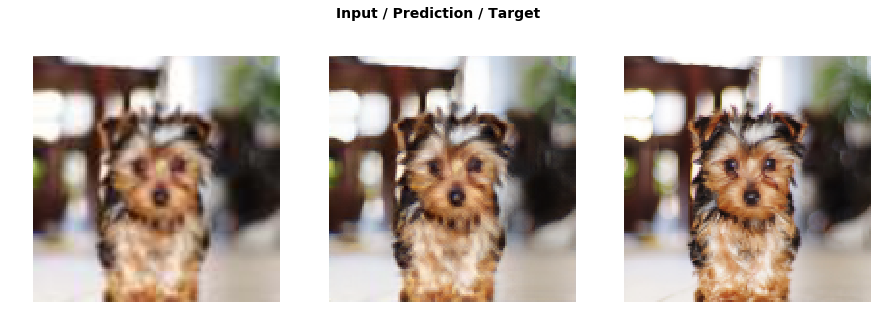

In [43]:
do_fit('wass_gram2', slice(1e-5,1e-3))

In [44]:
data = get_data(9,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2,gram0,gram1,gram2
1,3.298565,3.108443,0.164744,0.263379,0.303005,0.160051,0.364196,0.256951,0.277998,0.362013,0.588378,0.367729
2,3.278509,3.085051,0.167793,0.264391,0.302162,0.158745,0.354084,0.254863,0.275775,0.357158,0.585479,0.364601
3,3.216152,3.043790,0.169912,0.264531,0.300611,0.157560,0.342237,0.249792,0.271503,0.348105,0.577878,0.361660
4,3.150422,3.003307,0.170162,0.263040,0.298095,0.156374,0.332923,0.245786,0.264938,0.339358,0.574059,0.358571
5,3.105054,2.983803,0.172819,0.264301,0.297083,0.154343,0.327195,0.241471,0.262881,0.340025,0.568847,0.354837
6,3.092681,2.973960,0.172692,0.262207,0.293346,0.152577,0.333034,0.242076,0.258316,0.343189,0.565465,0.351059
7,3.055087,2.953434,0.171926,0.264677,0.294314,0.153947,0.320217,0.237500,0.256586,0.336910,0.562954,0.354401
8,3.045543,2.910578,0.172043,0.261712,0.293126,0.152397,0.312942,0.232371,0.252016,0.327357,0.556730,0.349884
9,3.028621,2.910573,0.173676,0.262263,0.291780,0.150966,0.313144,0.231740,0.249724,0.331479,0.558495,0.347306
10,2.961974,2.859207,0.169268,0.259474,0.288345,0.149193,0.304620,0.229519,0.244935,0.321603,0.548714,0.343536


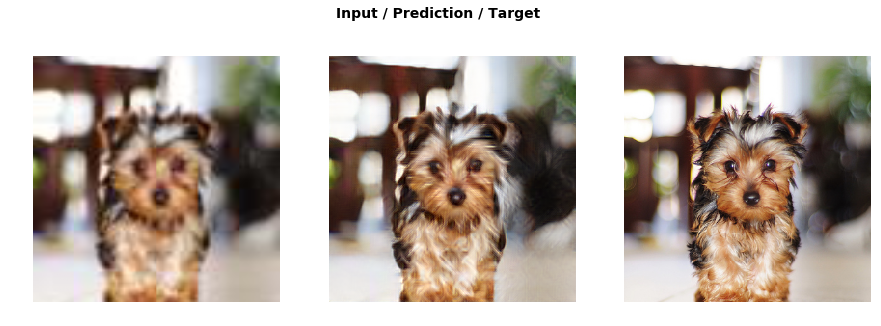

In [45]:
do_fit('wass_gram3')

In [46]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2,gram0,gram1,gram2
1,2.947331,2.855500,0.169426,0.259816,0.289014,0.149336,0.300944,0.229267,0.245048,0.320118,0.548622,0.343910
2,2.982004,2.852786,0.169855,0.260234,0.289084,0.149144,0.300397,0.227505,0.244214,0.320835,0.548277,0.343241
3,2.944706,2.850919,0.169328,0.259942,0.288113,0.148340,0.302479,0.227932,0.243206,0.322181,0.547439,0.341960
4,2.954471,2.839184,0.168622,0.258611,0.287834,0.148164,0.302842,0.227334,0.241503,0.318183,0.545135,0.340956
5,2.961594,2.841456,0.170281,0.259505,0.287876,0.148392,0.301227,0.226192,0.241878,0.319184,0.545455,0.341467
6,2.943418,2.829404,0.168405,0.259043,0.287593,0.147962,0.297613,0.225464,0.240877,0.317789,0.544248,0.340410
7,2.907521,2.827785,0.168840,0.259168,0.287438,0.147931,0.297751,0.225652,0.240279,0.316913,0.543454,0.340361
8,2.929201,2.829624,0.170099,0.259614,0.287945,0.148108,0.296029,0.225031,0.240613,0.317102,0.544485,0.340599
9,2.911865,2.827563,0.169569,0.259166,0.287418,0.147911,0.297634,0.225509,0.240362,0.316323,0.543401,0.340268
10,2.930930,2.822981,0.167688,0.258346,0.286930,0.147504,0.297507,0.225128,0.239629,0.317168,0.543340,0.339743


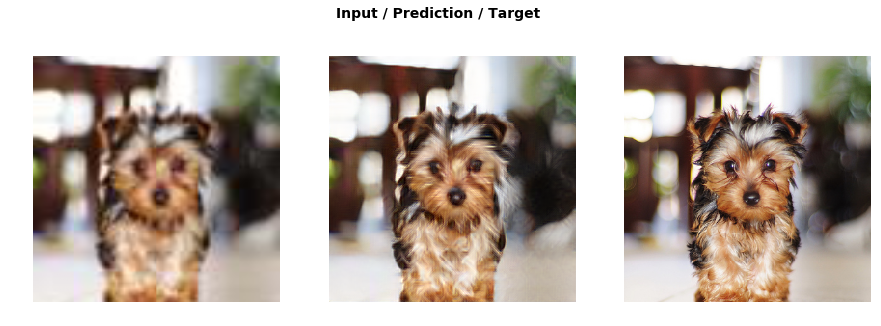

In [47]:
do_fit('wass_gram4', slice(1e-6,1e-4), pct_start=0.3)

In [61]:
learn.load('wass_gram4');

## Testing Perceptual + Wasserstein + Gram Loss

In [63]:
learn.data = data_mr

In [66]:
_,img_hr,b = learn.predict(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


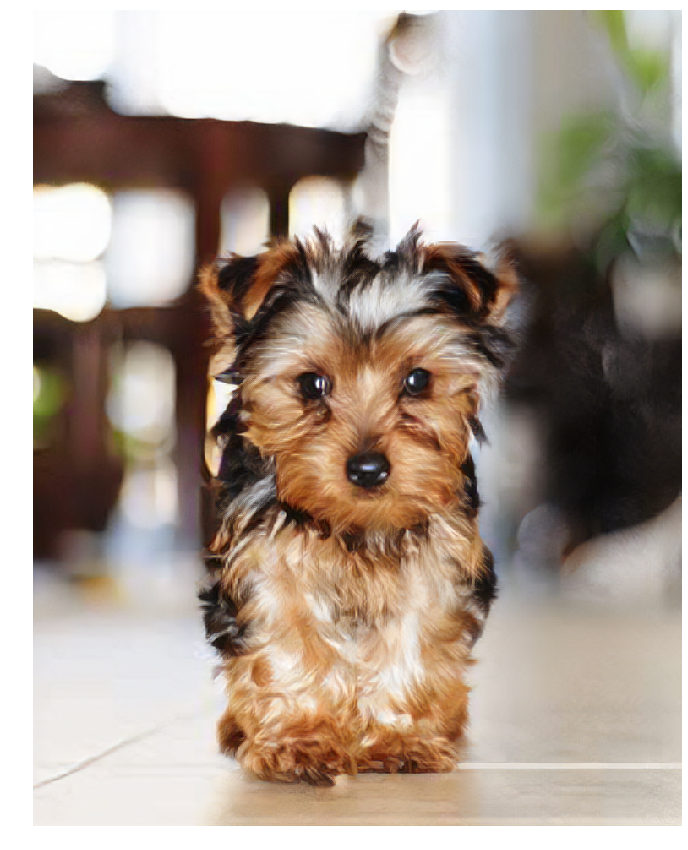

In [68]:
Image(img_hr).show(figsize=(18,15))

In [69]:
Image(img_hr.clamp(0, 1)).save('dog_wass_gram.png')

# Adding Attention

Now we add an attention layer to the U-Net

# Perceptual + Gram Loss with Attention

In [23]:
feat_loss = FeatureLoss(vgg_m, blocks[2:5], [5,15,2])

In [24]:
data = get_data(bs,size)
learn.data = data
learn.freeze()

In [25]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight, self_attention=True)
gc.collect();

Note the self attention layer added

In [26]:
learn.model

DynamicUnet(
  (layers): ModuleList(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace)
      (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (4): Sequential(
        (0): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (relu): ReLU(inplace)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        )
        (1): BasicBlock(
          (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


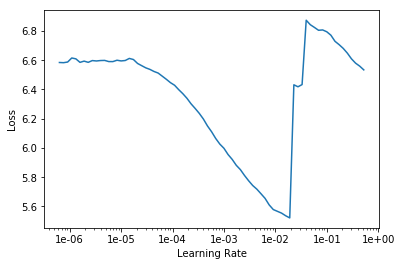

In [85]:
learn.lr_find()
learn.recorder.plot()

In [163]:
lr = 1e-3

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,3.918360,3.751414,0.148492,0.231447,0.318224,0.225465,0.559893,1.220855,1.047038
2,3.776176,3.573697,0.140906,0.224809,0.305525,0.213592,0.531967,1.161983,0.994915
3,3.722594,3.499729,0.145436,0.225397,0.302630,0.208722,0.502383,1.142370,0.972791
4,3.637240,3.465073,0.146746,0.222610,0.297997,0.205474,0.504774,1.129968,0.957503
5,3.584826,3.365039,0.143485,0.220151,0.292289,0.200714,0.483300,1.090365,0.934735
6,3.544475,3.322510,0.137811,0.218015,0.288787,0.198312,0.472550,1.079227,0.927807
7,3.497881,3.335613,0.142411,0.216288,0.288410,0.198163,0.482318,1.083266,0.924756
8,3.474856,3.241939,0.140263,0.217911,0.284928,0.194326,0.447092,1.048115,0.909305
9,3.444240,3.219384,0.138288,0.215178,0.281819,0.192594,0.447565,1.040066,0.903874
10,3.367663,3.127923,0.132854,0.213450,0.276996,0.186649,0.425813,1.019172,0.872990


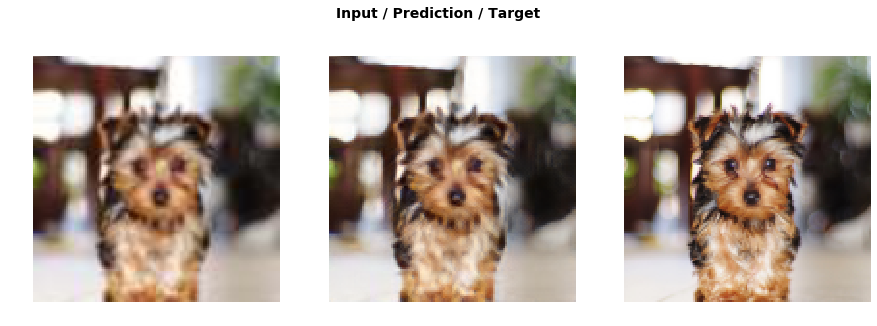

In [164]:
do_fit('gram_att1', slice(lr*10))

In [165]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,3.332432,3.117549,0.132770,0.213295,0.276446,0.186131,0.422538,1.016055,0.870313
2,3.321846,3.114733,0.132523,0.212757,0.275942,0.185957,0.423450,1.014744,0.869360
3,3.302893,3.107694,0.132629,0.212779,0.275545,0.185544,0.422071,1.012212,0.866914
4,3.302376,3.101108,0.132730,0.212748,0.275284,0.185115,0.419306,1.011162,0.864762
5,3.298229,3.102941,0.132811,0.212220,0.274888,0.185423,0.419682,1.010895,0.867021
6,3.297309,3.093560,0.133055,0.212206,0.274676,0.184759,0.417349,1.007326,0.864189
7,3.304736,3.089440,0.133491,0.212283,0.274357,0.185023,0.413686,1.004616,0.865984
8,3.301950,3.091899,0.132352,0.211887,0.273924,0.185095,0.416512,1.007035,0.865095
9,3.285437,3.072622,0.132171,0.211192,0.272742,0.183533,0.414593,1.000598,0.857791
10,3.276402,3.063995,0.132033,0.210904,0.272328,0.183064,0.412952,0.997796,0.854919


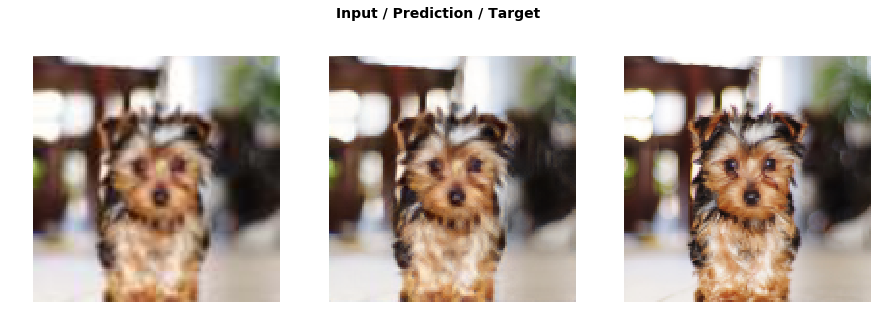

In [166]:
do_fit('gram_att2', slice(1e-5,1e-3))

In [33]:
data = get_data(10,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.235597,2.184669,0.159365,0.257160,0.293407,0.154006,0.378247,0.581108,0.361375
2,2.227823,2.157057,0.160009,0.258028,0.292769,0.153371,0.362041,0.573004,0.357836
3,2.170679,2.138793,0.160939,0.256859,0.290176,0.151438,0.358944,0.566372,0.354063
4,2.177220,2.124088,0.162304,0.257434,0.289097,0.151086,0.350470,0.562400,0.351298
5,2.164292,2.111731,0.162160,0.256736,0.286954,0.149499,0.348822,0.558720,0.348838
6,2.124212,2.107590,0.163914,0.256024,0.285755,0.148867,0.347338,0.559500,0.346191
7,2.129083,2.087462,0.163217,0.255809,0.284192,0.147325,0.339392,0.553721,0.343805
8,2.091091,2.070925,0.161319,0.254762,0.283156,0.146735,0.334949,0.548527,0.341479
9,2.114791,2.071201,0.160159,0.253942,0.282521,0.146072,0.338213,0.549996,0.340297
10,2.095372,2.047699,0.161342,0.253871,0.280717,0.144813,0.328424,0.541914,0.336617


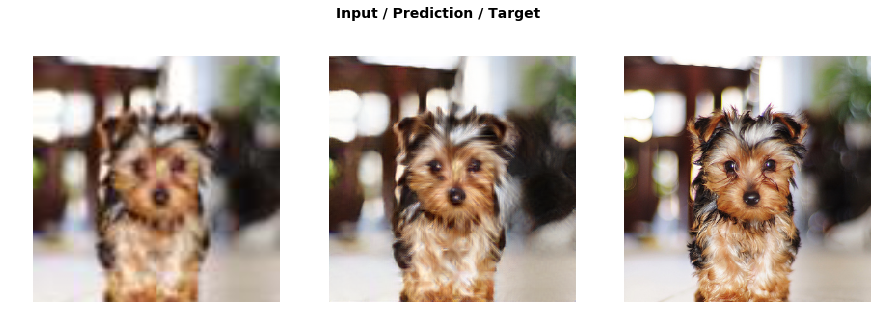

In [168]:
do_fit('gram_att3')

In [169]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,gram_0,gram_1,gram_2
1,2.083038,2.047137,0.162108,0.254248,0.280522,0.144585,0.328442,0.540972,0.336260
2,2.081760,2.044711,0.162064,0.253899,0.280637,0.144934,0.326911,0.540203,0.336063
3,2.065012,2.040867,0.161342,0.253006,0.279860,0.144143,0.328094,0.539496,0.334927
4,2.086681,2.037296,0.161225,0.253331,0.279736,0.144051,0.326263,0.538302,0.334389
5,2.047683,2.036254,0.160884,0.253134,0.279504,0.143756,0.326345,0.538645,0.333986
6,2.068422,2.034692,0.162020,0.253721,0.280025,0.144284,0.323417,0.536807,0.334419
7,2.053529,2.034063,0.162177,0.253597,0.279632,0.143706,0.324459,0.537123,0.333370
8,2.053706,2.032848,0.161893,0.253747,0.279864,0.143842,0.322969,0.536995,0.333539
9,2.049885,2.032034,0.162074,0.253523,0.279865,0.143920,0.322806,0.536343,0.333503
10,2.059832,2.030913,0.161577,0.253229,0.279706,0.143819,0.322927,0.536453,0.333202


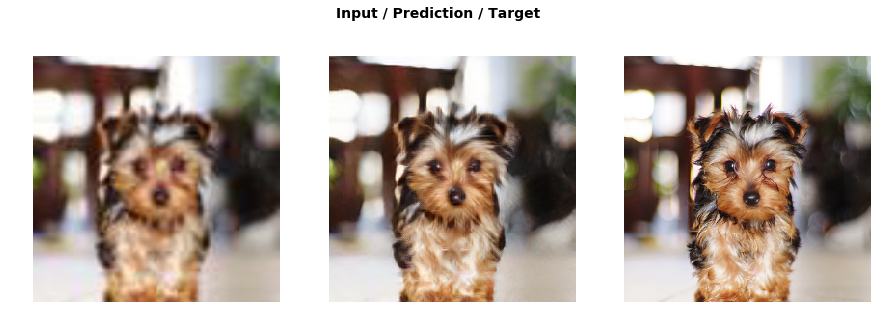

In [170]:
do_fit('gram_att4', slice(1e-6,1e-4), pct_start=0.3)

In [34]:
learn.load('gram_att4');

## Testing Perceptual + Gram With Attention

In [36]:
learn.data = data_mr

In [39]:
_,img_hr,b = learn.predict(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


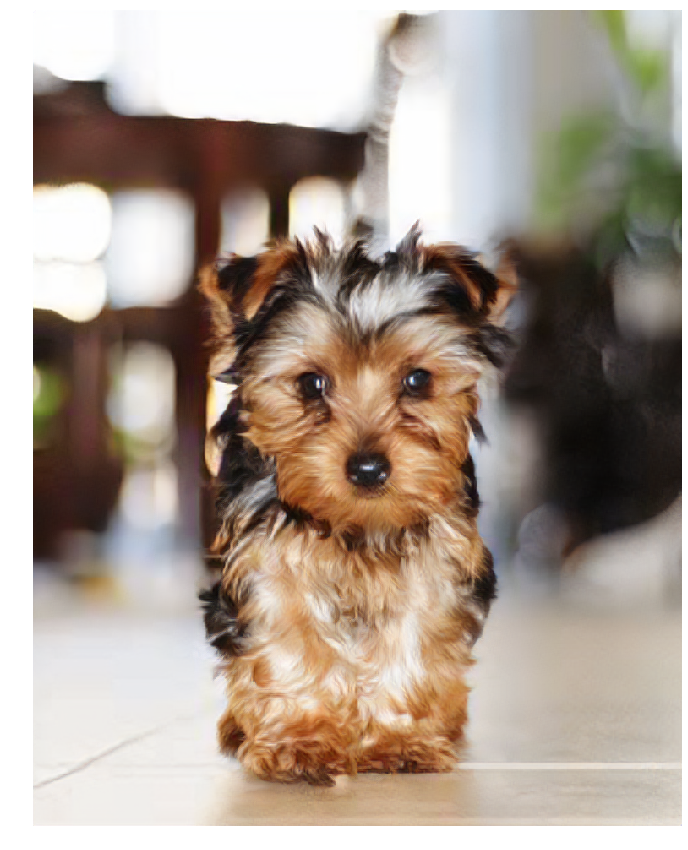

In [41]:
Image(img_hr).show(figsize=(18,15))

In [42]:
Image(img_hr.clamp(0, 1)).save('dog_gram_attn.png')

# Perceptual + Wasserstein with Attention

In [70]:
feat_loss = FeatureLoss_Wass(vgg_m, blocks[2:5], [5,15,2], [3, 0.7, 0.01])

In [71]:
data = get_data(bs,size)
learn.data = data
learn.freeze()

In [72]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight, self_attention=True)
gc.collect();

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


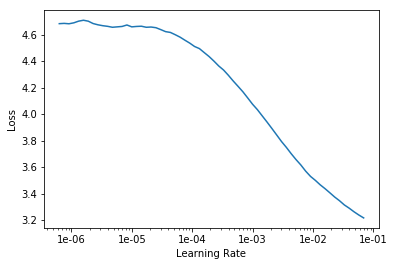

In [51]:
learn.lr_find()
learn.recorder.plot()

In [52]:
lr = 1e-3

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2
1,1.633229,1.459981,0.143979,0.232380,0.321920,0.230940,0.133310,0.142571,0.254881
2,1.565396,1.414349,0.143985,0.232903,0.318065,0.224459,0.119752,0.133149,0.242036
3,1.509334,1.349405,0.138037,0.227360,0.306434,0.215963,0.113168,0.126421,0.222021
4,1.485953,1.312250,0.135196,0.224818,0.299730,0.210378,0.106330,0.120822,0.214977
5,1.450439,1.287096,0.136831,0.221440,0.295134,0.208698,0.105483,0.113826,0.205684
6,1.421539,1.267715,0.132579,0.221931,0.293943,0.205571,0.099598,0.111706,0.202386
7,1.392789,1.247751,0.138631,0.219623,0.290771,0.201946,0.095895,0.107453,0.193432
8,1.378861,1.222574,0.134769,0.215312,0.285691,0.196908,0.097622,0.105379,0.186893
9,1.358227,1.222767,0.133047,0.216755,0.286672,0.197328,0.095673,0.107497,0.185794
10,1.309426,1.167826,0.127950,0.212729,0.277968,0.190710,0.086448,0.098080,0.173941


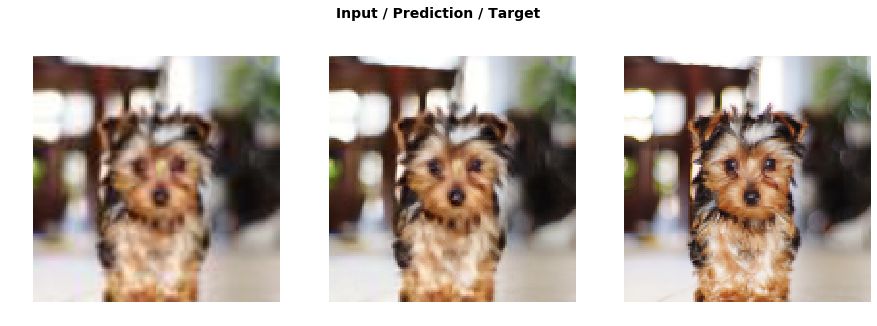

In [53]:
do_fit('wass_att1', slice(lr*10))

In [54]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2
1,1.305216,1.164825,0.128139,0.212743,0.277594,0.189976,0.085775,0.097732,0.172869
2,1.302855,1.163285,0.128170,0.212704,0.277433,0.189601,0.085451,0.097426,0.172500
3,1.303806,1.163176,0.128034,0.212513,0.277231,0.189718,0.085333,0.097574,0.172772
4,1.297980,1.157251,0.127609,0.211616,0.276082,0.188721,0.085460,0.096976,0.170788
5,1.298443,1.153714,0.128319,0.211519,0.275739,0.188331,0.083984,0.096116,0.169705
6,1.301978,1.152547,0.127862,0.211497,0.275748,0.188072,0.083528,0.095705,0.170135
7,1.301532,1.152038,0.128748,0.212045,0.275689,0.187813,0.083070,0.095812,0.168861
8,1.289701,1.149837,0.128746,0.210807,0.274695,0.187600,0.083627,0.095542,0.168821
9,1.282421,1.148591,0.127633,0.210779,0.274801,0.187726,0.082727,0.095782,0.169144
10,1.282343,1.140520,0.127372,0.210105,0.273407,0.186442,0.082205,0.094378,0.166611


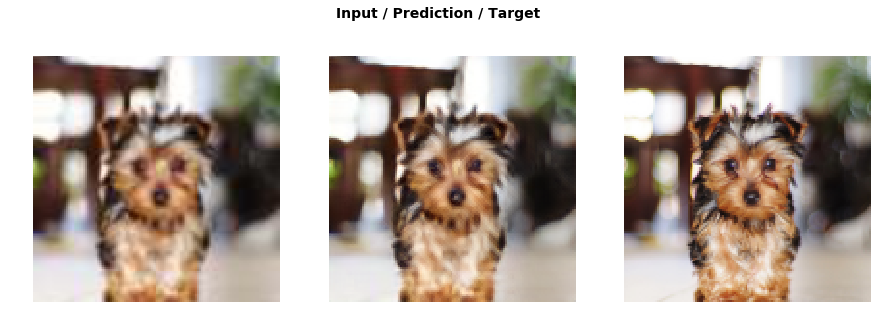

In [55]:
do_fit('wass_att2', slice(1e-5,1e-3))

In [56]:
data = get_data(8,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2
1,1.504514,1.367399,0.157534,0.259778,0.298986,0.158966,0.208437,0.139246,0.144453
2,1.471317,1.350171,0.157858,0.258320,0.295833,0.156182,0.203840,0.136776,0.141362
3,1.438838,1.340409,0.159671,0.259127,0.294776,0.155050,0.197515,0.134920,0.139350
4,1.440999,1.324525,0.159673,0.258336,0.292440,0.153465,0.190056,0.133234,0.137320
5,1.421847,1.311895,0.160169,0.256246,0.289187,0.151433,0.190352,0.130261,0.134247
6,1.404539,1.304079,0.159997,0.257913,0.289047,0.151665,0.183927,0.128246,0.133284
7,1.398693,1.298979,0.158718,0.256157,0.286746,0.149783,0.186217,0.129322,0.132035
8,1.379445,1.313526,0.165131,0.258181,0.286459,0.150495,0.191248,0.129919,0.132092
9,1.382508,1.287653,0.161792,0.256828,0.286444,0.148713,0.178131,0.126064,0.129680
10,1.363686,1.269453,0.159173,0.254948,0.283759,0.147731,0.172462,0.124582,0.126798


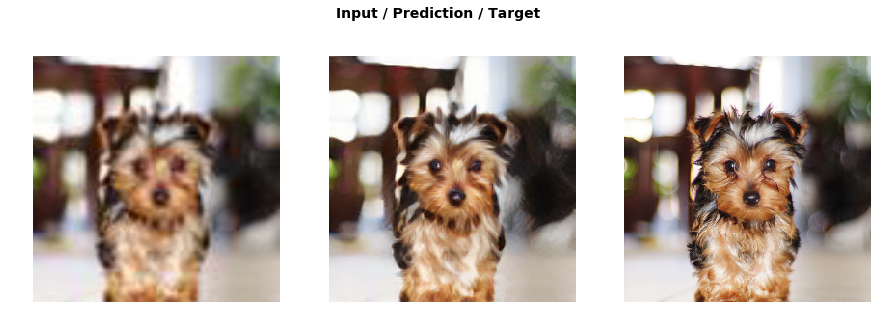

In [57]:
do_fit('wass_att3')

In [58]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2
1,1.349390,1.268168,0.159241,0.254647,0.282919,0.147243,0.173170,0.124380,0.126569
2,1.345837,1.267855,0.159113,0.254247,0.282661,0.146989,0.174518,0.124216,0.126109
3,1.338486,1.267093,0.159490,0.254976,0.282992,0.147073,0.172261,0.123932,0.126369
4,1.344971,1.265005,0.159700,0.254809,0.282489,0.146971,0.172261,0.123138,0.125636
5,1.348794,1.260745,0.159200,0.254251,0.282283,0.146605,0.170057,0.123136,0.125213
6,1.348760,1.260005,0.158766,0.253851,0.281775,0.145958,0.171489,0.123379,0.124787
7,1.344141,1.256719,0.158329,0.253311,0.281139,0.145679,0.171471,0.122479,0.124311
8,1.327098,1.256837,0.158457,0.253286,0.280977,0.145951,0.170912,0.122885,0.124371
9,1.337517,1.256646,0.158588,0.253242,0.281141,0.145729,0.171091,0.122672,0.124183
10,1.343744,1.255925,0.158478,0.253404,0.281291,0.145745,0.170436,0.122489,0.124082


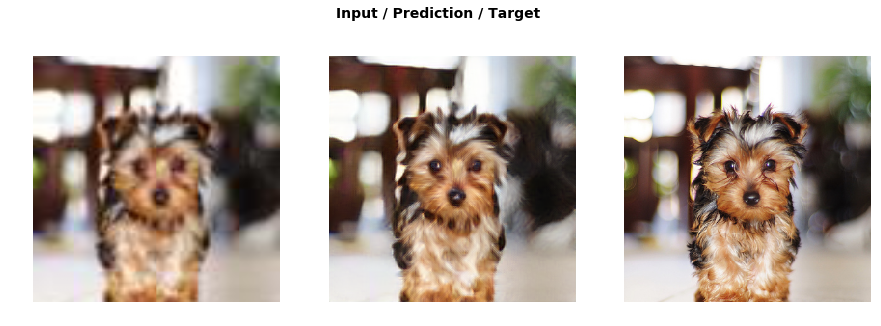

In [59]:
do_fit('wass_att4', slice(1e-6,1e-4), pct_start=0.3)

In [73]:
learn.load('wass_att4');

## Testing Perceptual + Wasserstein with Attention

In [75]:
learn.data = data_mr

In [78]:
_,img_hr,b = learn.predict(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


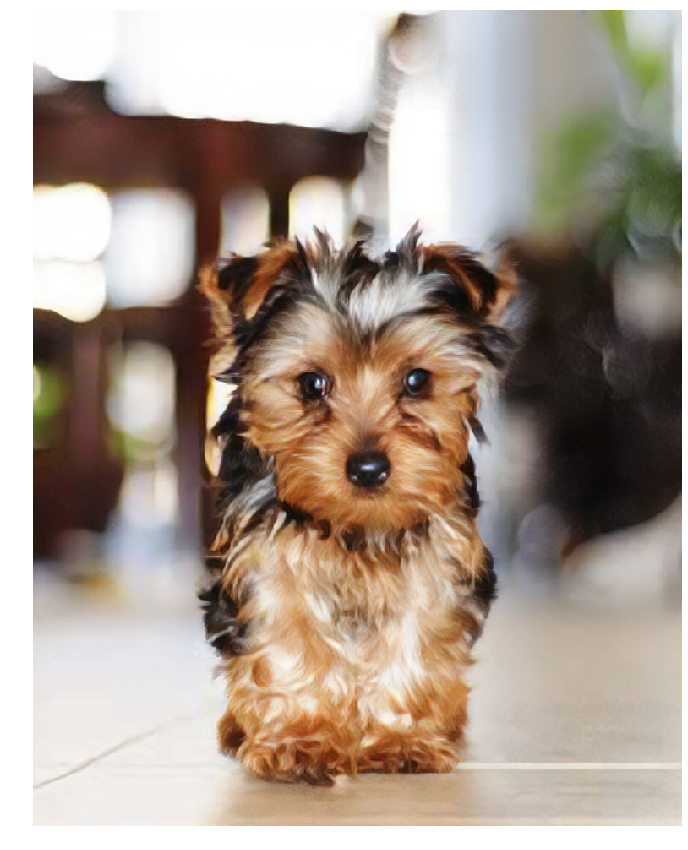

In [80]:
Image(img_hr).show(figsize=(18,15))

In [81]:
Image(img_hr.clamp(0, 1)).save('dog_wass_attn.png')

# Perceptual + Wasserstein + Gram with Attention

In [43]:
feat_loss = FeatureLoss_Wass_Gram(vgg_m, blocks[2:5], [5,15,2], [3, 0.7, 0.01])

In [44]:
data = get_data(bs,size)
learn.data = data
learn.freeze()

In [45]:
wd = 1e-3
learn = unet_learner(data, arch, wd=wd, loss_func=feat_loss, callback_fns=LossMetrics,
                     blur=True, norm_type=NormType.Weight, self_attention=True)
gc.collect();

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


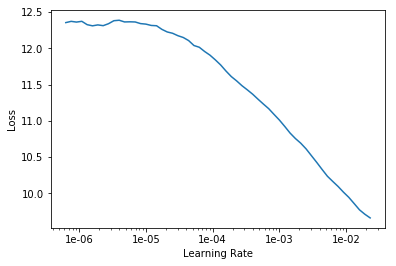

In [174]:
learn.lr_find()
learn.recorder.plot()

In [175]:
lr = 1e-3

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2,gram0,gram1,gram2
1,5.369389,5.057821,0.163341,0.243671,0.331727,0.230753,0.289553,0.323303,0.539594,0.591265,1.280178,1.064435
2,5.013710,4.657072,0.148491,0.233764,0.314049,0.219709,0.240717,0.272180,0.475747,0.533537,1.194579,1.024300
3,4.838366,4.485770,0.150926,0.229238,0.307620,0.212040,0.222222,0.249706,0.443462,0.516550,1.163423,0.990582
4,4.759774,4.329606,0.138192,0.226240,0.300978,0.207094,0.204614,0.231623,0.421701,0.498100,1.132463,0.968600
5,4.691782,4.289503,0.141428,0.224298,0.296804,0.204907,0.205082,0.233025,0.410010,0.499482,1.117859,0.956608
6,4.587962,4.194325,0.155597,0.223864,0.294879,0.202606,0.192268,0.219217,0.395904,0.469600,1.098040,0.942350
7,4.521986,4.166739,0.155580,0.222672,0.291810,0.200827,0.188060,0.214795,0.394196,0.470165,1.090650,0.937985
8,4.472203,4.125564,0.144343,0.219982,0.289197,0.198797,0.190046,0.213198,0.385584,0.476794,1.077392,0.930230
9,4.425892,4.040251,0.144207,0.218800,0.286108,0.194860,0.186570,0.208287,0.372382,0.451921,1.063423,0.913693
10,4.256364,3.890975,0.134217,0.216604,0.280420,0.189359,0.170923,0.198545,0.352956,0.429706,1.032338,0.885908


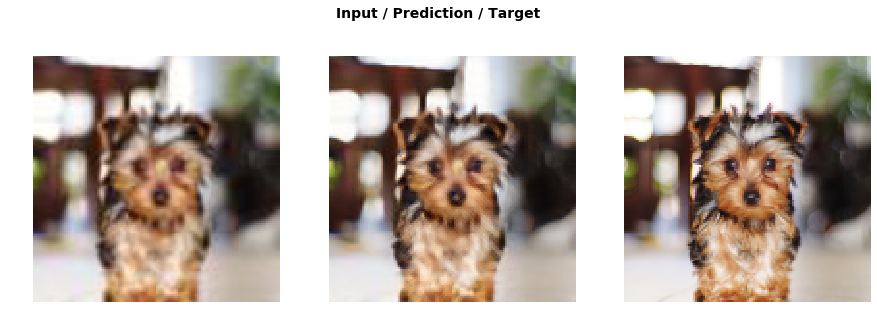

In [176]:
do_fit('wass_gram_att1', slice(lr*10))

In [177]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2,gram0,gram1,gram2
1,4.220209,3.877007,0.133980,0.216082,0.279618,0.188810,0.171278,0.197267,0.350062,0.426969,1.029058,0.883884
2,4.228129,3.867440,0.134169,0.216152,0.279511,0.188491,0.169938,0.195951,0.348052,0.425137,1.027280,0.882760
3,4.192941,3.860593,0.133384,0.215510,0.278777,0.187895,0.169960,0.196129,0.347383,0.425415,1.025685,0.880455
4,4.189298,3.847836,0.134070,0.215550,0.278483,0.187618,0.167690,0.193466,0.345433,0.424715,1.022783,0.878029
5,4.179706,3.847164,0.135214,0.214732,0.277884,0.187286,0.168232,0.193505,0.345028,0.424499,1.022205,0.878579
6,4.180109,3.841761,0.133948,0.215475,0.278580,0.187432,0.167013,0.193044,0.345538,0.420508,1.022422,0.877801
7,4.157911,3.838419,0.134540,0.214482,0.277412,0.186949,0.171622,0.191973,0.344150,0.422761,1.018611,0.875920
8,4.173788,3.810213,0.133916,0.214152,0.276421,0.185815,0.165353,0.190925,0.339662,0.418395,1.013583,0.871990
9,4.172175,3.817353,0.134158,0.214597,0.277013,0.186185,0.167746,0.191798,0.341168,0.417402,1.014920,0.872366
10,4.131619,3.787650,0.133488,0.213864,0.275699,0.184976,0.163513,0.188833,0.336654,0.415035,1.009598,0.865989


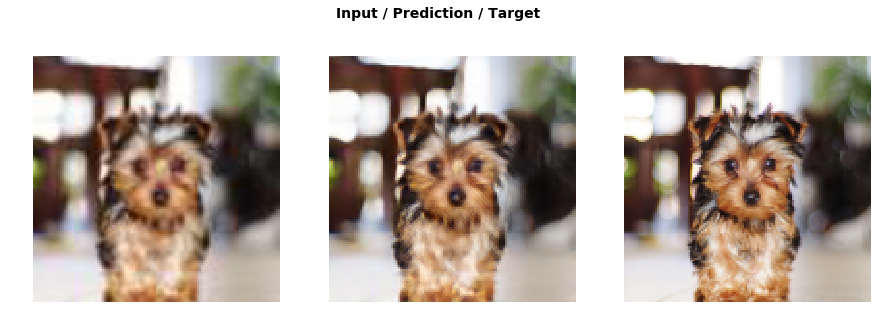

In [178]:
do_fit('wass_gram_att2', slice(1e-5,1e-3))

In [46]:
data = get_data(8,size*2)
learn.data = data
learn.freeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2,gram0,gram1,gram2
1,3.392139,3.200055,0.165089,0.263980,0.303994,0.161185,0.404310,0.282254,0.295233,0.364148,0.590563,0.369297
2,3.349927,3.155646,0.167322,0.264768,0.302797,0.159896,0.387750,0.276748,0.290693,0.355291,0.584343,0.366037
3,3.263035,3.118910,0.168920,0.264214,0.299772,0.157059,0.381836,0.273354,0.284804,0.351630,0.576836,0.360485
4,3.250109,3.078933,0.169810,0.264780,0.298972,0.156144,0.365461,0.266629,0.280226,0.344870,0.573983,0.358057
5,3.223599,3.038356,0.169571,0.263699,0.296700,0.154748,0.355097,0.265026,0.274540,0.336362,0.567189,0.355424
6,3.188309,3.025931,0.170272,0.261769,0.293769,0.153279,0.355332,0.264419,0.270313,0.338810,0.565908,0.352061
7,3.138974,3.029375,0.172278,0.262150,0.294061,0.153261,0.358705,0.262907,0.269824,0.337732,0.566966,0.351490
8,3.128040,3.005874,0.167673,0.260816,0.292380,0.151709,0.353125,0.261866,0.265366,0.339656,0.564880,0.348402
9,3.065492,2.984146,0.169027,0.259718,0.290305,0.150409,0.356212,0.256989,0.263372,0.335497,0.555948,0.346670
10,3.038575,2.927404,0.168491,0.260206,0.289743,0.149425,0.333617,0.251064,0.258140,0.323204,0.549919,0.343595


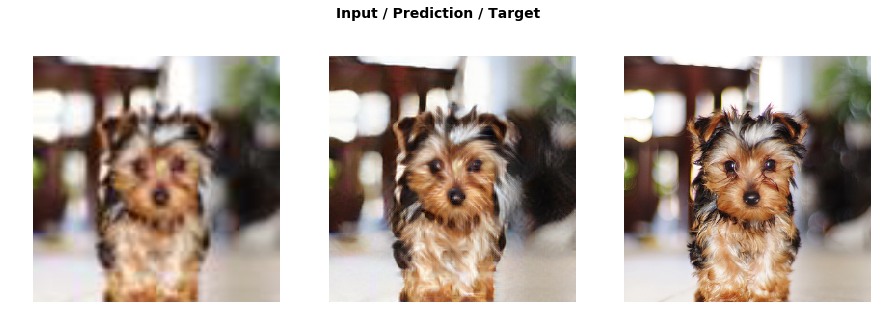

In [180]:
do_fit('wass_gram_att3')

In [181]:
learn.unfreeze()

epoch,train_loss,valid_loss,pixel,feat_0,feat_1,feat_2,wass_0,wass_1,wass_2,gram0,gram1,gram2
1,3.020015,2.924253,0.169025,0.260203,0.289776,0.149323,0.332262,0.250955,0.257727,0.322067,0.549796,0.343119
2,3.054556,2.920849,0.169345,0.260148,0.289358,0.149201,0.331958,0.250723,0.256952,0.321674,0.548818,0.342674
3,3.018561,2.917317,0.167976,0.259647,0.288637,0.148514,0.333128,0.251047,0.255749,0.322648,0.548631,0.341340
4,2.991009,2.912573,0.169946,0.259690,0.288714,0.148636,0.331585,0.250301,0.254739,0.320504,0.547138,0.341319
5,3.033622,2.907304,0.169216,0.260028,0.288721,0.148333,0.329296,0.249132,0.254775,0.320613,0.546655,0.340534
6,3.007936,2.900179,0.169307,0.260017,0.289014,0.148444,0.326467,0.248126,0.254018,0.318178,0.545990,0.340617
7,3.001164,2.898797,0.168960,0.259576,0.288102,0.148099,0.330397,0.247428,0.253379,0.319092,0.543900,0.339864
8,2.984968,2.898709,0.170086,0.260027,0.288856,0.148265,0.326850,0.247794,0.253288,0.318150,0.545525,0.339868
9,3.008647,2.897668,0.169657,0.260120,0.288571,0.148172,0.325916,0.248460,0.253104,0.318092,0.545877,0.339700
10,2.984104,2.893819,0.168687,0.259504,0.287945,0.147765,0.326778,0.248120,0.252596,0.318272,0.545051,0.339101


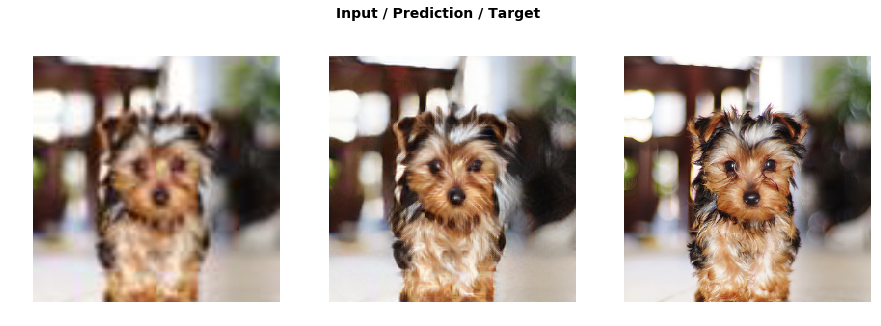

In [182]:
do_fit('wass_gram_att4', slice(1e-6,1e-4), pct_start=0.3)

In [47]:
learn.load('wass_gram_att4');

## Testing Perceptual + Wasserstein + Gram with Attention

In [49]:
learn.data = data_mr

In [52]:
_,img_hr,b = learn.predict(img)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


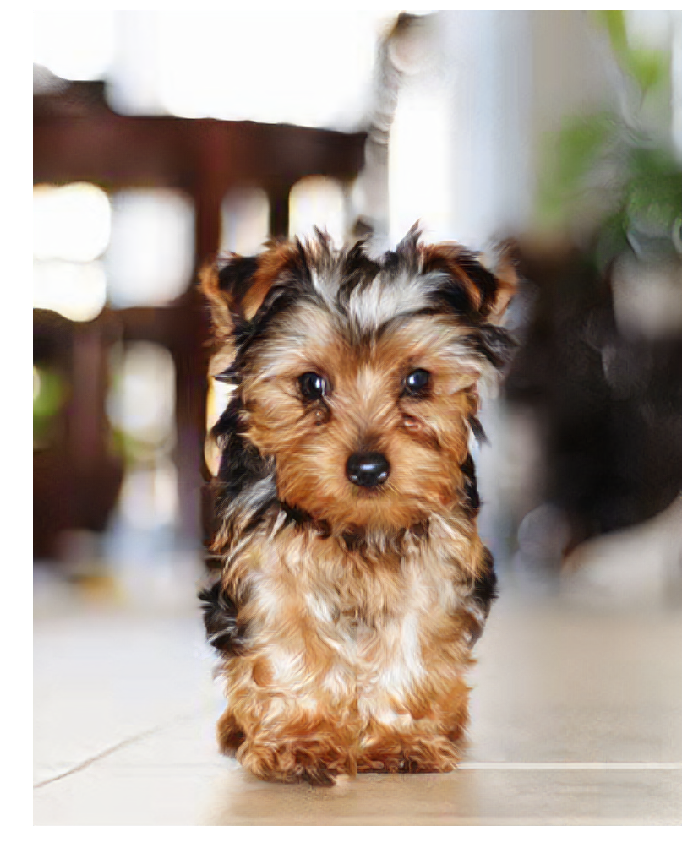

In [54]:
Image(img_hr).show(figsize=(18,15))

In [55]:
Image(img_hr.clamp(0, 1)).save('dog_wass_gram_attn.png')

# Image Comparisons

In [60]:
img_percep = open_image('dog_percep.png')
img_wass = open_image('dog_wass_only.png')
img_gram = open_image('dog_gram.png')

img_pw = open_image('dog_wass.png')
img_pg = open_image('dog_percep_gram.png')
img_pwg = open_image('dog_wass_gram.png')

img_pwa = open_image('dog_wass_attn.png')
img_pga = open_image('dog_gram_attn.png')
img_pwga = open_image('dog_wass_gram_attn.png')

In [71]:
ims = [img_gram, img_pg, img_pga,
       img_wass, img_pw, img_pwa,
       img_percep, img_pwg, img_pwga]

titles = ['Gram', 'Perceptual + Gram', 'Perceptual + Gram + Attention',
          'Wasserstein', 'Perceptual + Wasserstein', 'Perceptual + Wasserstein + Attention', 
          'Perceptual', 'Perceptual + Wasserstein + Gram', 'Perceptual + Wasserstein + Gram + Attention']

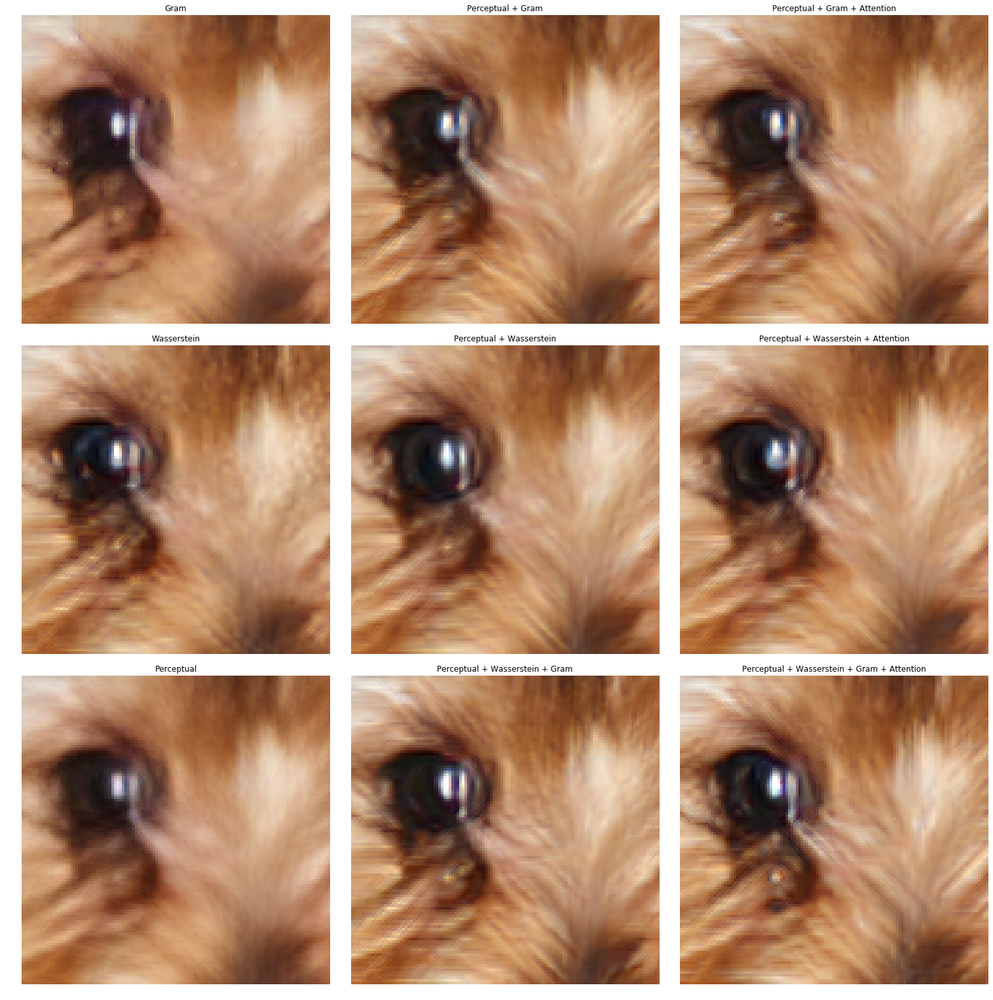

In [72]:
ims_slice = [i.data[:, 400:520, 300:420] for i in ims]

fig, axes = plt.subplots(3, 3, figsize=(21, 21))

for i, ax in enumerate(axes.flat):
    show_image(ims_slice[i], ax=ax)
    ax.set_title(titles[i])
plt.tight_layout(pad=0.01)

fig.savefig('eye_composite.png', bbox_inches='tight')
fig.savefig('eye_composite_highdpi.png', bbox_inches='tight', dpi=200)

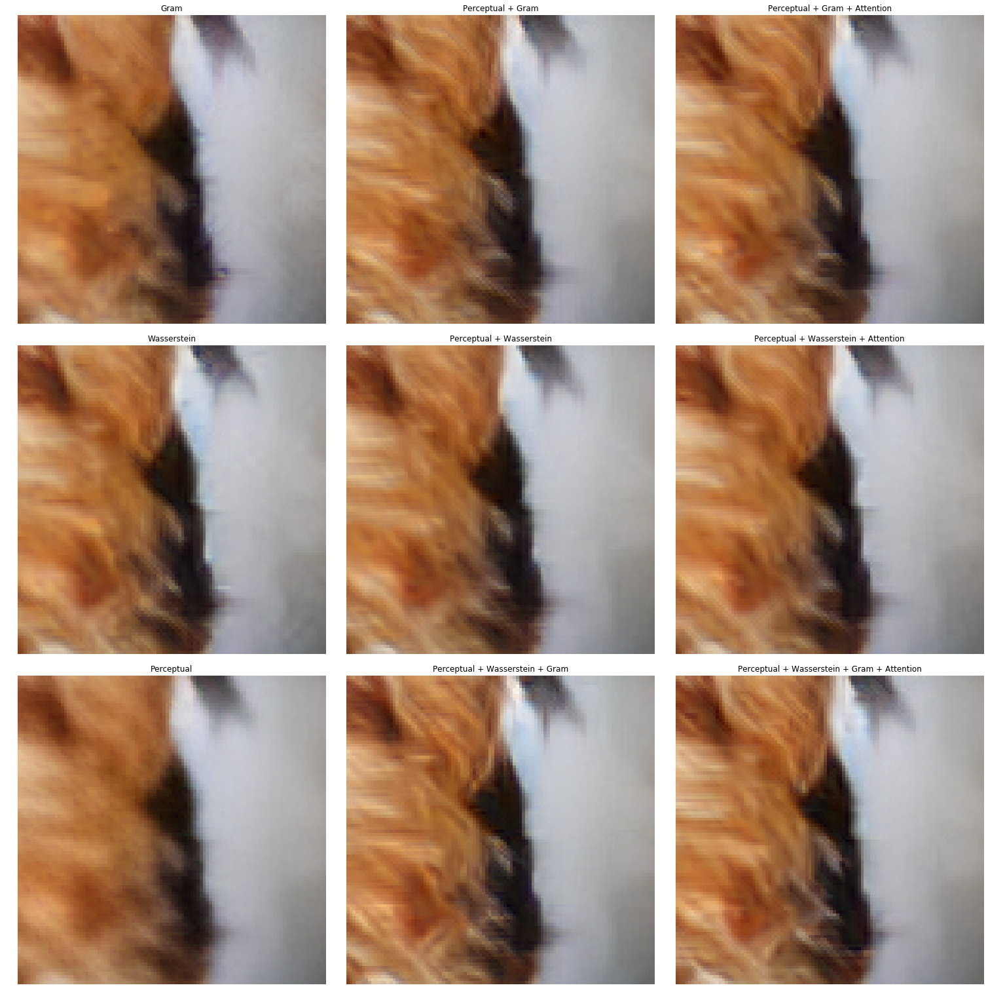

In [73]:
ims_slice = [i.data[:, 500:600, 465:565] for i in ims]

fig, axes = plt.subplots(3, 3, figsize=(21, 21))

for i, ax in enumerate(axes.flat):
    show_image(ims_slice[i], ax=ax)
    ax.set_title(titles[i])
plt.tight_layout(pad=0.01)

fig.savefig('side_composite.png', bbox_inches='tight')
fig.savefig('side_composite_highdpi.png', bbox_inches='tight', dpi=200)

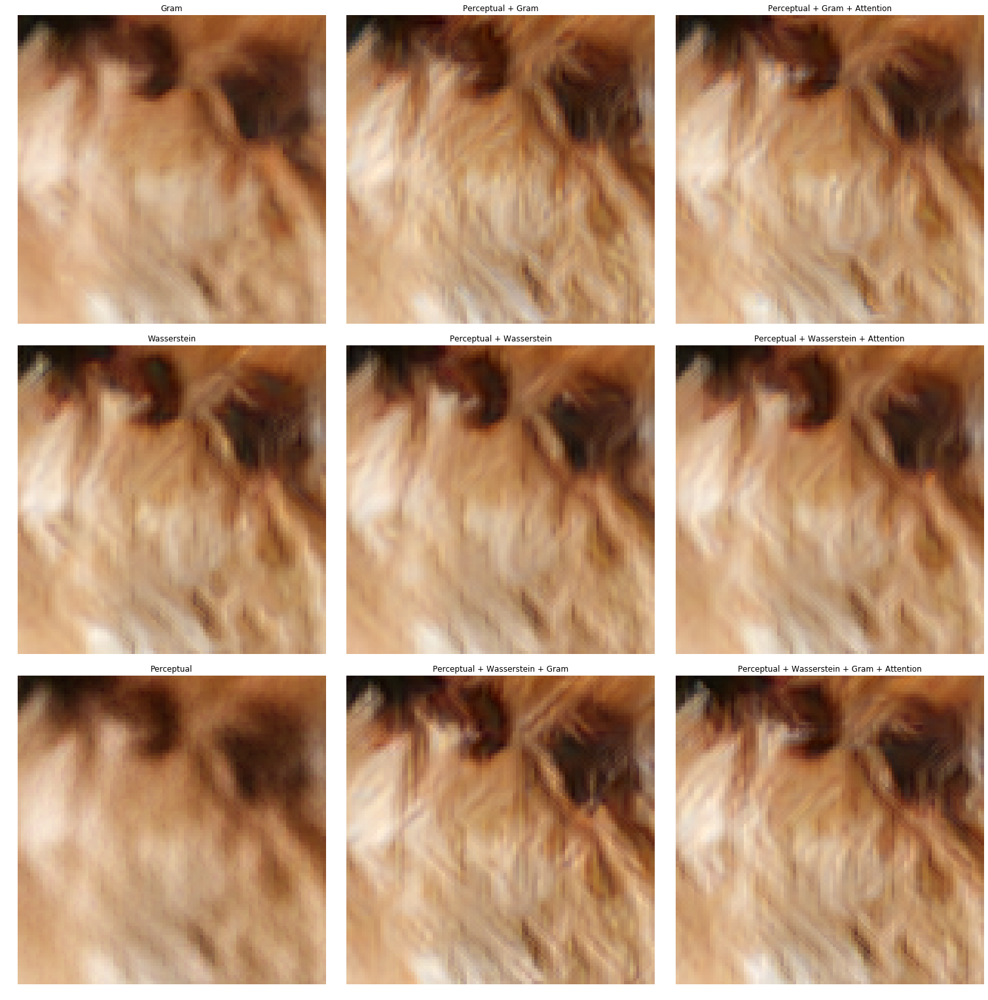

In [74]:
ims_slice = [i.data[:, 600:700, 300:400] for i in ims]

fig, axes = plt.subplots(3, 3, figsize=(21, 21))

for i, ax in enumerate(axes.flat):
    show_image(ims_slice[i], ax=ax)
    ax.set_title(titles[i])
plt.tight_layout(pad=0.01)

fig.savefig('fur_composite.png', bbox_inches='tight')
fig.savefig('fur_composite_highdpi.png', bbox_inches='tight', dpi=200)

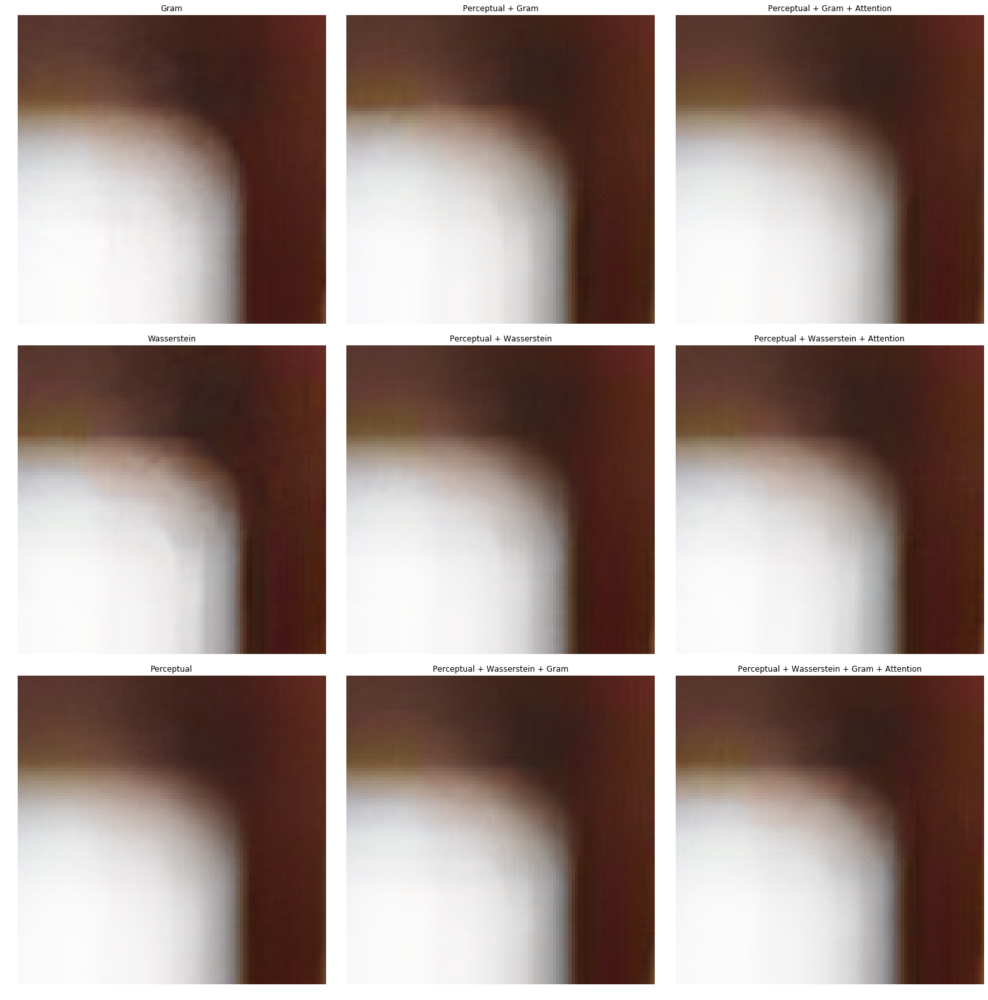

In [75]:
ims_slice = [i.data[:, 180:280, 120:220] for i in ims]

fig, axes = plt.subplots(3, 3, figsize=(21, 21))

for i, ax in enumerate(axes.flat):
    show_image(ims_slice[i], ax=ax)
    ax.set_title(titles[i])
plt.tight_layout(pad=0.01)

fig.savefig('edge_composite.png', bbox_inches='tight')
fig.savefig('edge_composite_highdpi.png', bbox_inches='tight', dpi=200)

# Takeaways

Here's some thoughts I have after making this notebook. A lot of this is subjective evaluation of pixel quality. I would encourage you to look at the output images, especially the high dpi versions, and draw your own conclusions.

### Compound losses give better performance

Using perceptual loss, Gram matrix loss, or L2-Wasserstein loss alone gives poor, blurry results.

### Effects of attention 

It is hard to see any major effects caused by adding self attention. In the dog's eye, adding attention seems to bring out spots of red or blue. On the macro scale, it's hard to see a difference.

### Gram vs Wasserstein

Using a L2-Wasserstein metric seems to give better results than using a Gram matrix metric. Gram matrix images have kind of a spiky unevenness on the pixel level. Wasserstein images look smoother and more even.

### The best performer

If I had to choose one model, I think perceptual loss + L2-Wasserstein loss gives the best performance.